# Impact calculations with data from OpenStreetMap

In [1]:
import matplotlib.pyplot as plt
import shapely
import contextily as ctx
from pathlib import Path
from datetime import datetime
import numpy as np
import pandas as pd

from climada.util.api_client import Client
import climada.util.lines_polys_handler as u_lp
from climada.engine.impact_calc import ImpactCalc
from climada.entity.impact_funcs import ImpactFuncSet, ImpactFunc
from climada.entity.impact_funcs.storm_europe import ImpfStormEurope
from climada.entity import Exposures
from climada.entity import LitPop
from climada import CONFIG

from climada_petals.entity.exposures.openstreetmap.osm_dataloader import OSMRaw, OSMFileQuery
from climada_petals.entity.exposures.openstreetmap.osm_dataloader import DICT_CIS_OSM

## Prepare OSM data 

### Getting OSM Files

In [2]:
# download osm.pbf file for Switzerland from geofabrik
DATA_DIR = CONFIG.exposures.openstreetmap.local_data.dir()
OSMRaw().get_data_geofabrik('CHE', file_format='pbf', save_path=DATA_DIR)

In [4]:
# Initiate a OSMFileQuery instance with path to the downloaded file
SwissFileQuery = OSMFileQuery(Path(DATA_DIR,'switzerland-latest.osm.pbf'))

### Extracting geo-data from OSM files

In [3]:
DICT_CIS_OSM.keys()

dict_keys(['education', 'healthcare', 'water', 'telecom', 'road', 'rail', 'air', 'gas', 'oil', 'power', 'wastewater', 'food'])

In [4]:
DICT_CIS_OSM['healthcare']

{'osm_keys': ['amenity', 'building', 'healthcare', 'name'],
 'osm_query': "amenity='hospital' or healthcare='hospital' or\n                             building='hospital' or building='clinic' or\n                             amenity='clinic' or healthcare='clinic' or\n                             amenity='doctors' or healthcare='doctors'\n                             "}

In [5]:
# Initiate a OSMFileQuery instance with path to the downloaded file
SwissFileQuery = OSMFileQuery(Path(DATA_DIR,'switzerland-latest.osm.pbf'))

### Healthcare infrastructure

In [5]:
gdf_health = SwissFileQuery.retrieve_cis('healthcare')

extract multipolygons: 100%|████████████████| 1403/1403 [01:02<00:00, 22.58it/s]
/Users/ckropf/Documents/Climada/climada_petals/climada_petals/entity/exposures/openstreetmap/osm_dataloader.py:561: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  gdf = gdf.append(


In [7]:
# Pre-processing: duplicate entry removal

In [6]:
def _find_duplicates(overlap_gdf):
    indices_dupl = np.unique([index_right for index_right, index_left in zip(overlap_gdf.index_right, overlap_gdf.index_left)
                    if index_right != index_left])
    indices_dupl = indices_dupl[:int(len(indices_dupl/2))] # only first half of duplicates should be removed!
    return indices_dupl

def _remove_duplicates(orig_gdf, indices_dupl):
    indices_keep = list(set(orig_gdf.index).difference(set(indices_dupl)))
    return orig_gdf.loc[indices_keep]

def find_remove_duplicates(orig_gdf):
    if 'index' in orig_gdf.columns:
        orig_gdf = orig_gdf.drop('index', axis=1)
    overlap_gdf = orig_gdf.sjoin(orig_gdf)
    if 'index_left' not in overlap_gdf.columns:
        overlap_gdf = overlap_gdf.reset_index()
        overlap_gdf = overlap_gdf.rename({'index':'index_left'}, axis=1)  
    indices_dupl = _find_duplicates(overlap_gdf)
    return _remove_duplicates(orig_gdf, indices_dupl)   

In [7]:
gdf_health = gdf_health.reset_index(drop=True)
gdf_health_pnt = gdf_health[gdf_health.geometry.type=='Point']
gdf_health_pnt['geometry'] = gdf_health_pnt.geometry.buffer(0.001) # ca. 100m buffer
gdf_health_poly = gdf_health[gdf_health.geometry.type=='MultiPolygon']

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_43839/1801640668.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_health_pnt['geometry'] = gdf_health_pnt.geometry.buffer(0.001) # ca. 100m buffer


In [8]:
gdf_health_pnt = find_remove_duplicates(gdf_health_pnt)
gdf_health_poly = find_remove_duplicates(gdf_health_poly)

In [9]:
gdf_health = pd.concat([gdf_health_pnt, gdf_health_poly])
gdf_health = find_remove_duplicates(gdf_health)
gdf_health['geometry'] = gdf_health.geometry.centroid

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_43839/2613931195.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_health['geometry'] = gdf_health.geometry.centroid


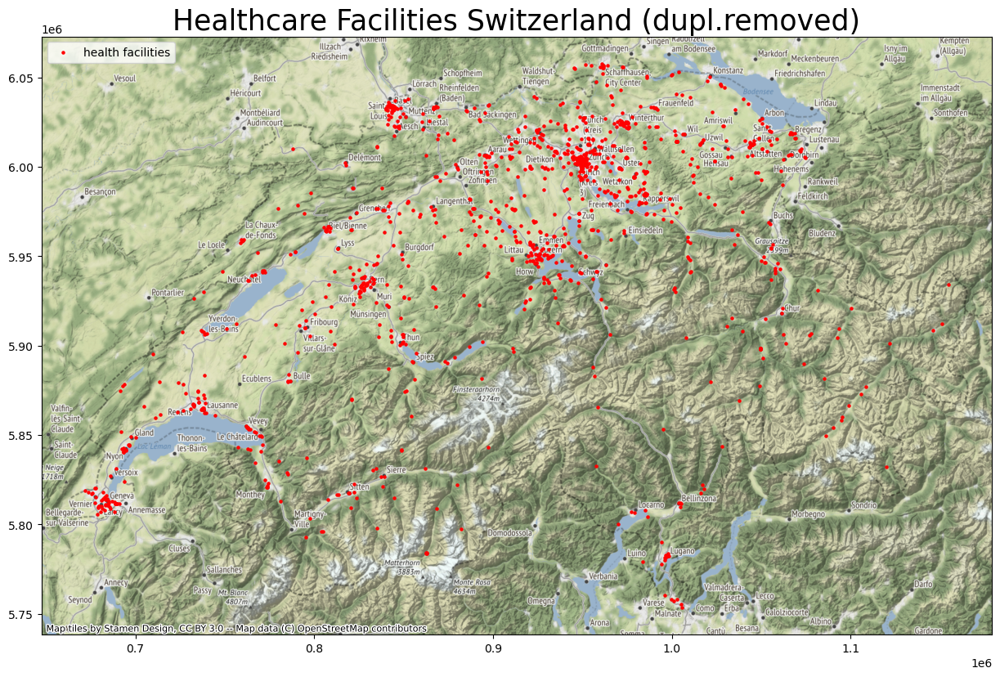

In [11]:
ax = gdf_health.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(15, 15), alpha=1, markersize=5, color='red', 
                    edgecolor='red', label='health facilities')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('Healthcare Facilities Switzerland (dupl.removed)', fontsize=25)
ctx.add_basemap(ax)
plt.show()

### Airports

In [12]:
gdf_airports_orig = SwissFileQuery.retrieve_cis('air')

extract multipolygons: 100%|████████████████████| 15/15 [00:37<00:00,  2.49s/it]


In [13]:
# pre-processing: duplicate entry removal
import copy
gdf_airports = copy.deepcopy(gdf_airports_orig.reset_index(drop=True))
gdf_airports_pnt = gdf_airports[gdf_airports.geometry.type=='Point']
gdf_airports_pnt['geometry'] = gdf_airports_pnt.geometry.buffer(0.001) # ca. 100m buffer
gdf_airports_poly = gdf_airports[gdf_airports.geometry.type=='MultiPolygon']

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_43839/2794811889.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'buffer' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_airports_pnt['geometry'] = gdf_airports_pnt.geometry.buffer(0.001) # ca. 100m buffer


In [14]:
gdf_airports_poly = find_remove_duplicates(gdf_airports_poly)
gdf_airports_pnt = find_remove_duplicates(gdf_airports_pnt)

In [15]:
gdf_airports = pd.concat([gdf_airports_pnt, gdf_airports_poly])
gdf_airports = find_remove_duplicates(gdf_airports)
gdf_airports['geometry'] = gdf_airports.geometry.centroid

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_43839/1963958413.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_airports['geometry'] = gdf_airports.geometry.centroid


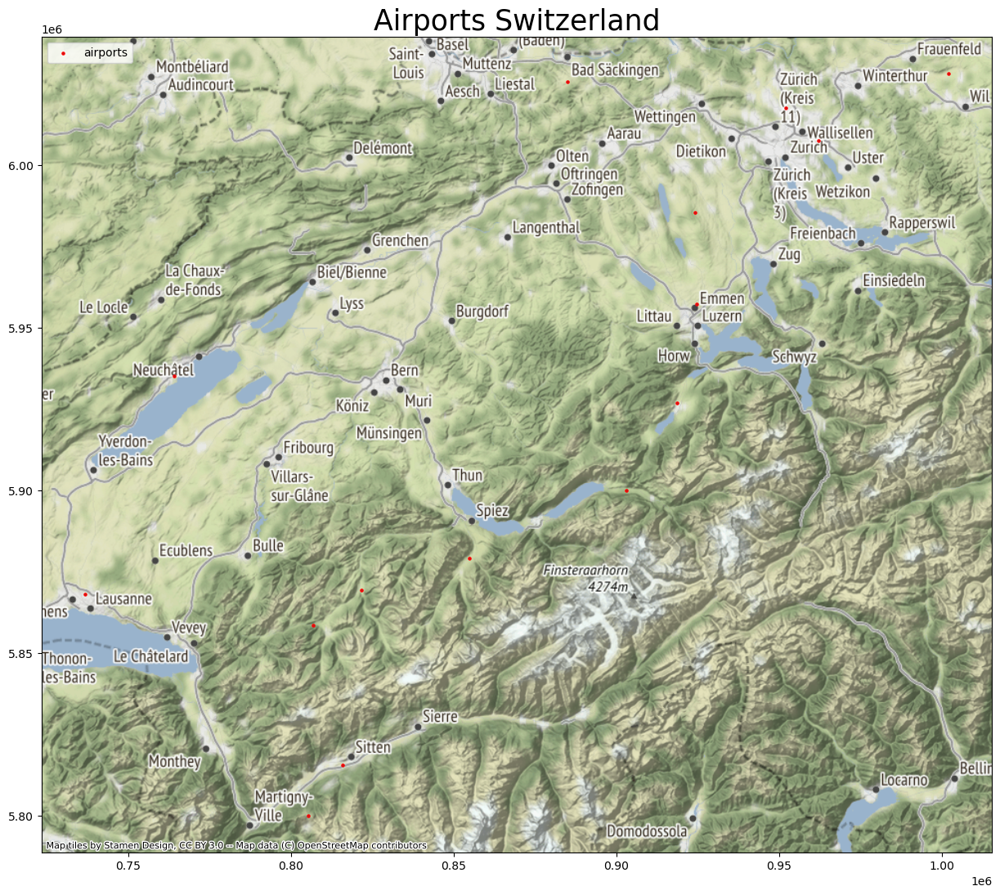

In [16]:
# plot results
ax = gdf_airports.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(15, 15), alpha=1, markersize=5, color='brown', 
                    edgecolor='red', label='airports')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('Airports Switzerland', fontsize=25)
ctx.add_basemap(ax)
plt.show()

### Railways

In [17]:
osm_keys=['railway', 'name']
osm_query="railway='rail' or railway='tram' or railway='light_rail' or railway='narrow_gauge'"

gdf_rails = SwissFileQuery.retrieve('lines', osm_keys, osm_query)

extract lines: 100%|████████████████████| 50514/50514 [00:16<00:00, 3112.83it/s]


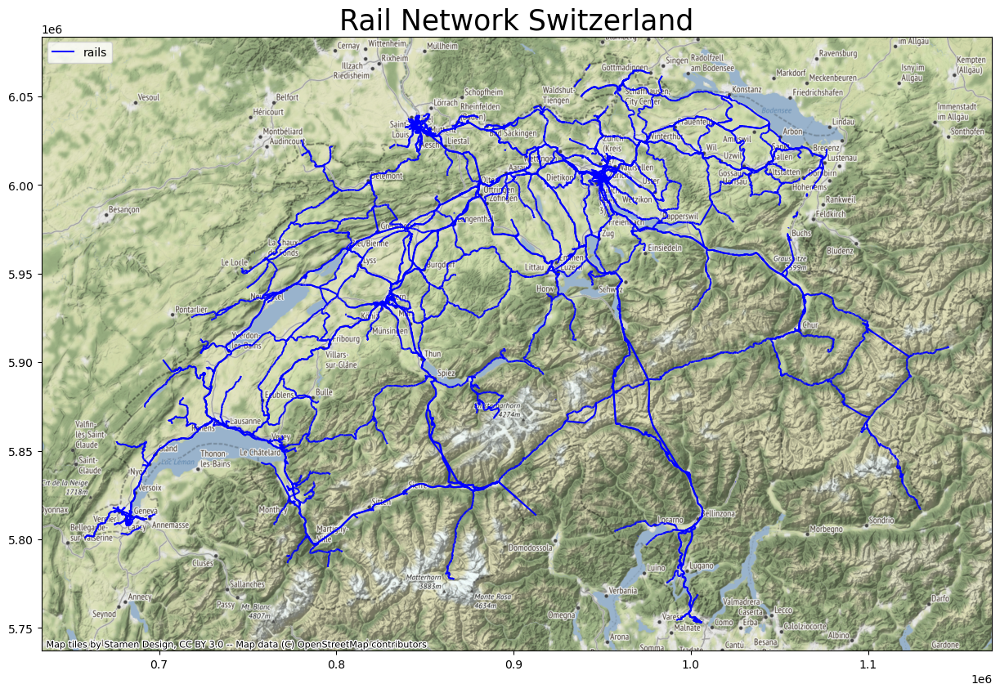

In [18]:
# plot results
ax = gdf_rails.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(15, 15), alpha=1, markersize=5, color='blue', 
                    edgecolor='blue', label='rails')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('Rail Network Switzerland', fontsize=25)
ctx.add_basemap(ax)
plt.show()

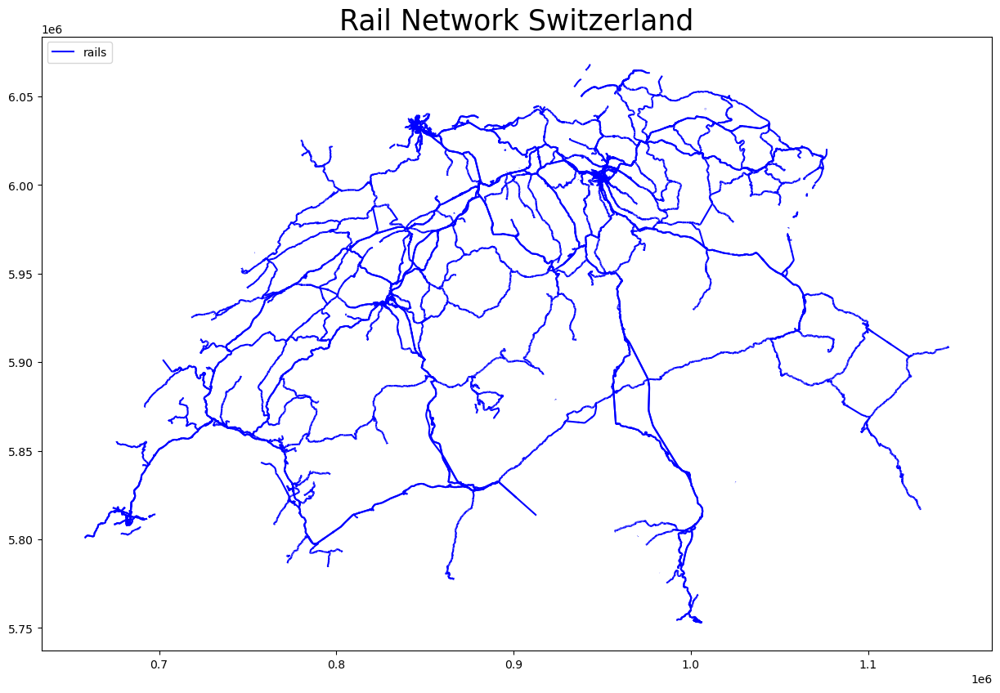

In [19]:
ax = gdf_rails.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(15, 15), alpha=1, markersize=5, color='blue', 
                    edgecolor='blue', label='rails')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('Rail Network Switzerland', fontsize=25)
plt.show()

### Forests 

In [20]:
# Forests in Switzerland
osm_keys = ['landuse']
osm_query = "landuse='forest'"
gdf_forest = SwissFileQuery.retrieve('multipolygons', osm_keys, osm_query)

extract multipolygons: 100%|████████████| 76090/76090 [00:43<00:00, 1745.47it/s]


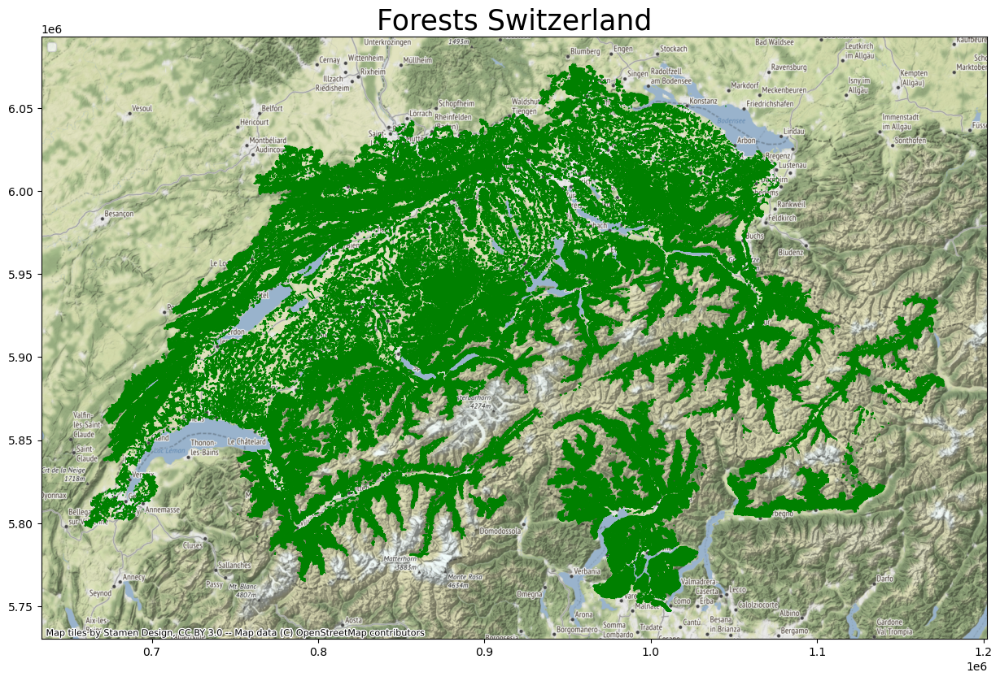

In [21]:
# plot results
ax = gdf_forest.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(15, 15), alpha=1, markersize=5, color='green', 
                    edgecolor='green', label='forest')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('Forests Switzerland', fontsize=25)
ctx.add_basemap(ax)
plt.show()

In [22]:
# do some cleaning: only valid shapes, not very tiny ones
import shapely
def make_valid(geometry):
    if geometry.is_valid:
        return geometry
    return geometry.buffer(0.0001)

In [23]:
gdf_forest['geometry'] = gdf_forest.apply(lambda row: make_valid(row.geometry), axis=1)
gdf_forest = gdf_forest[gdf_forest['geometry'].area > 1e-5]

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:387: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  iter(obj)  # Can iterate over it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:388: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  len(obj)  # Has a length associated with it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:1784: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number o

In [24]:
# consumes too much memory
# shapely.ops.unary_union(gdf_forest.geometry)
# shapely.ops.unary_union(gdf_forest['geometry'][gdf_forest['geometry'].type=='MultiPolygon'])

### UNESCO Cultural Heritage Sites

In [30]:
unesco_query = {
    'osm_keys': ['heritage_operator', 'name', 'heritage'],
    'osm_query': "heritage_operator='whc'"
}

In [31]:
gdf_list = []
for shape in ['points', 'lines', 'multipolygons']:
    try:
        gdf = SwissFileQuery.retrieve(shape, unesco_query['osm_keys'], unesco_query['osm_query'])
        gdf_list.append(gdf)
    except TypeError:
        print(f'{shape} not found')
gdf_unesco = pd.concat(gdf_list)
gdf_unesco

extract points: 100%|█████████████████████████████| 8/8 [00:06<00:00,  1.29it/s]
extract lines: 0it [00:09, ?it/s]
extract multipolygons: 100%|██████████████████████| 3/3 [00:37<00:00, 12.57s/it]


,osm_id,heritage_operator,name,heritage,geometry
0,26863957,whc,Monte San Giorgio,1,POINT (8.94989 45.91376)
1,1453589407,whc,Morges - Les Roseaux,1,POINT (6.50810 46.51484)
2,1453589408,whc,Morges - Stations de Morges,1,POINT (6.50258 46.50943)
3,2194901120,whc,Altstadt,1,POINT (7.45127 46.94829)
4,2195309046,whc,UNESCO-Welterbe - Lobsigesee,1,POINT (7.29772 47.03162)
5,3256406527,whc,Castelgrande,1,POINT (9.02175 46.19290)
6,3256443027,whc,Castello di Montebello,1,POINT (9.02657 46.19129)
7,3256443038,whc,Castello di Sasso Corbaro,1,POINT (9.03013 46.18812)
0,None,whc,Stiftsbezirk,1,"MULTIPOLYGON (((9.37641 47.42251, 9.37605 47.4..."
1,None,whc,Stiftskirche,1,"MULTIPOLYGON (((9.37747 47.42317, 9.37722 47.4..."


/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_43839/4000003835.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_unesco_plot.geometry = gdf_unesco_plot.geometry.centroid


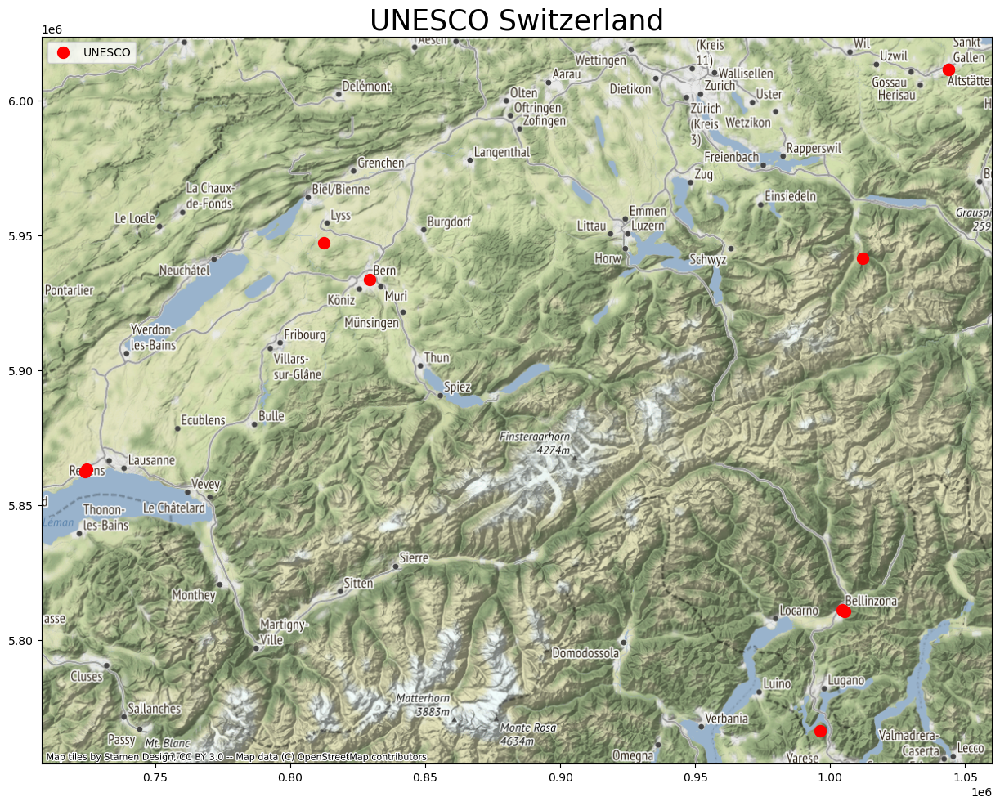

In [32]:
# plot results
gdf_unesco_plot = gdf_unesco.copy()
gdf_unesco_plot.geometry = gdf_unesco_plot.geometry.centroid
ax = gdf_unesco_plot.set_crs(epsg=4326).to_crs(epsg=3857).plot(figsize=(15, 15), alpha=1, markersize=100, color='red', 
                    edgecolor='red', label='UNESCO')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
ax.set_title('UNESCO Switzerland', fontsize=25)
ctx.add_basemap(ax)
plt.show()

## Loading Hazard Data

In [33]:
# Let's take european winter storms
client = Client()
ws_che = client.get_hazard('storm_europe', properties={'country_name': 'Switzerland'})

https://climada.ethz.ch/data-api/v1/dataset	country_name=Switzerland	data_type=storm_europe	limit=100000	name=None	status=active	version=None


In [34]:
print(datetime.fromordinal(int(np.min(ws_che.date))))
print(datetime.fromordinal(int(np.max(ws_che.date))))

1940-11-01 00:00:00
2013-12-05 00:00:00


In [35]:
# Lothar happened around Dec 26, 1999
date_lothar_start = datetime(1999, 12, 25)
date_lothar_end = datetime(1999, 12, 31)

date_lothar_start_ordinal = date_lothar_start.toordinal()
date_lothar_end_ordinal = date_lothar_end.toordinal()

In [36]:
ws_lothar = ws_che.select(orig=True, date=[date_lothar_start_ordinal, date_lothar_end_ordinal])
# ugly work-around for making eai_exp plot an at_event plot later --> frequency = 1
ws_lothar.frequency = np.array([1])

<GeoAxesSubplot:title={'center':'WS max intensity at each point'}>

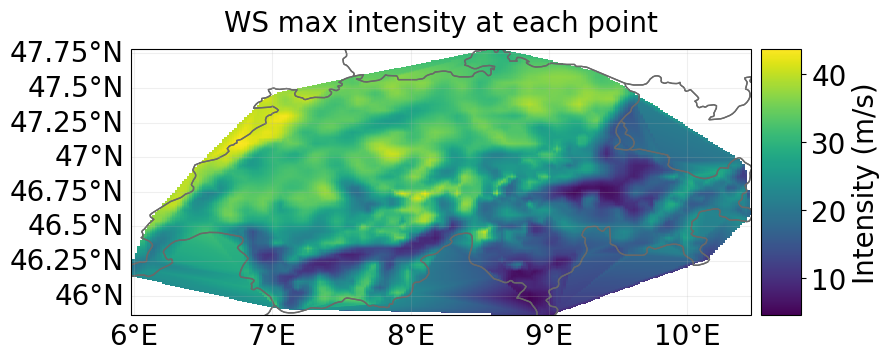

In [37]:
ws_lothar.plot_intensity(0)

<GeoAxesSubplot:title={'center':'Event ID 15229: 15229'}>

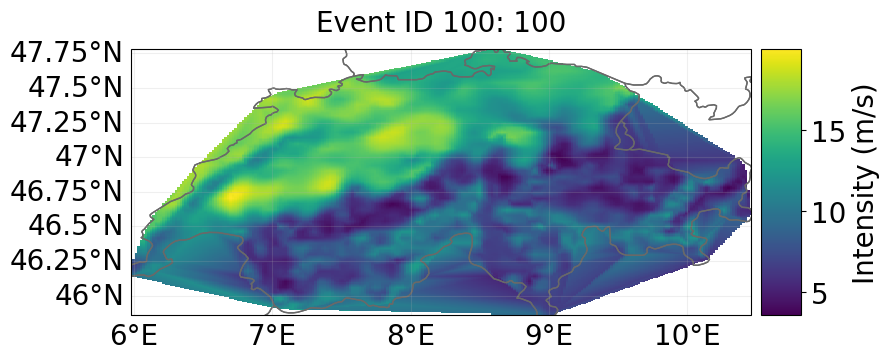

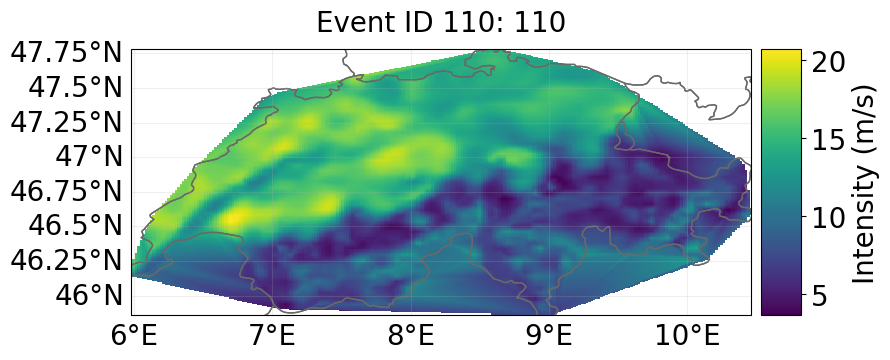

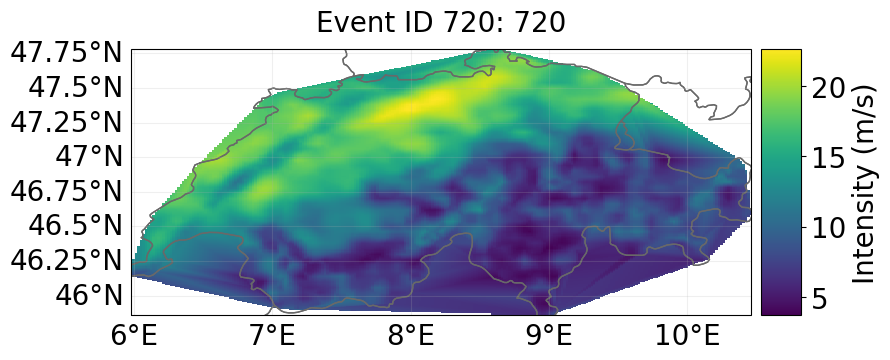

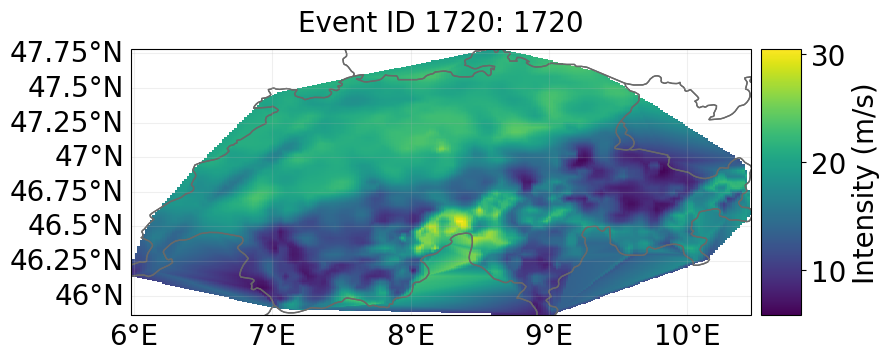

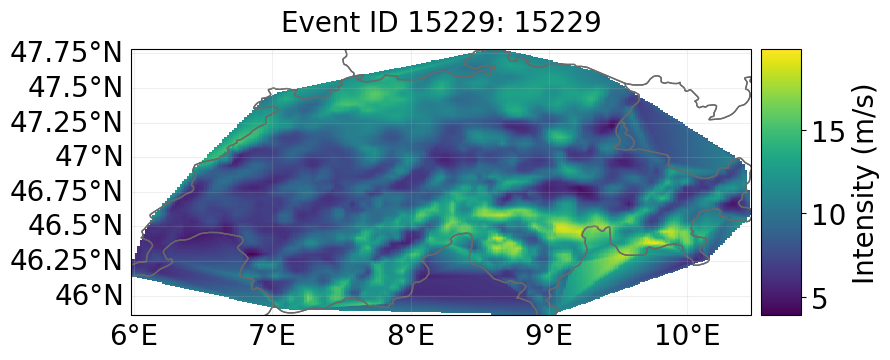

In [38]:
ws_che.plot_intensity(event=ws_che.event_id[0])
ws_che.plot_intensity(event=ws_che.event_id[10])
ws_che.plot_intensity(event=ws_che.event_id[200])
ws_che.plot_intensity(event=ws_che.event_id[500])
ws_che.plot_intensity(event=ws_che.event_id[-1])

In [39]:
# Vivian happened around Feb 27, 1990
date_vivian_start = datetime(1990, 2, 26)
date_vivian_end = datetime(1990, 2, 28)

date_vivian_start_ordinal = date_vivian_start.toordinal()
date_vivian_end_ordinal = date_vivian_end.toordinal()

<GeoAxesSubplot:title={'center':'WS max intensity at each point'}>

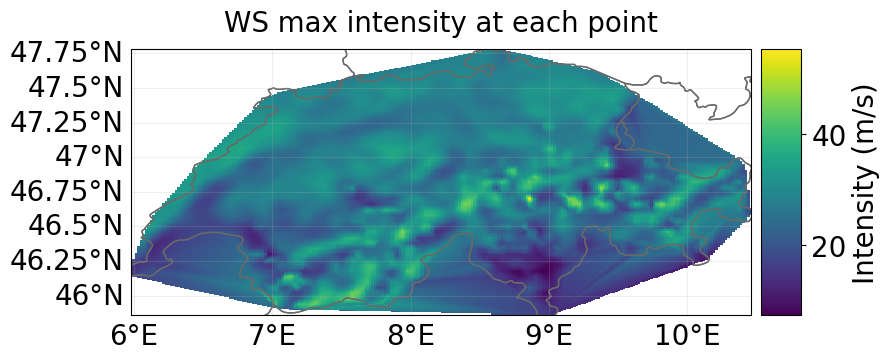

In [40]:
ws_vivian = ws_che.select(orig=True, date=[date_vivian_start_ordinal, date_vivian_end_ordinal])
# ugly work-around for making eai_exp plot an at_event plot later --> frequency = 1
ws_vivian.frequency = np.array([1])
ws_vivian.plot_intensity(0)

## Defining impact functions

In [41]:
impf_set = ImpactFuncSet()

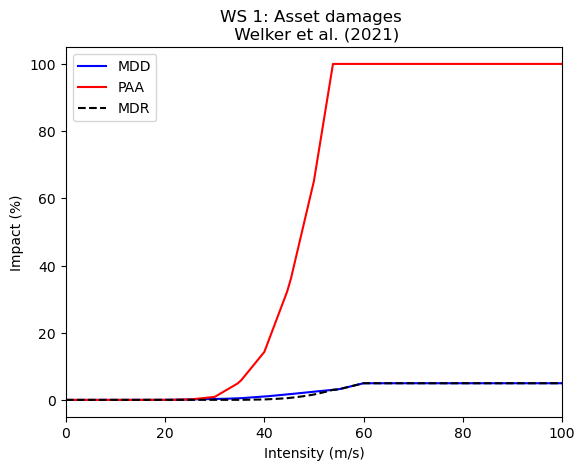

In [42]:
impf_welker = ImpfStormEurope.from_welker()
impf_welker.name = 'Asset damages \n Welker et al. (2021)'
impf_set.append(impf_welker)
impf_set.check()
impf_set.plot();

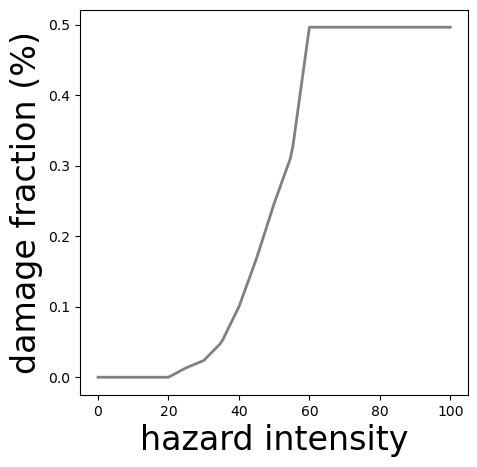

In [43]:
# "random" df for schematic plot
fig, axes = plt.subplots(1,1, figsize=(5, 5), sharey='row')
lp1 = axes.plot(impf_welker.intensity, impf_welker.mdd*10, 'gray', linewidth=2);
axes.set_xlabel('hazard intensity', fontsize=24);
axes.set_ylabel('damage fraction (%)', fontsize=24);

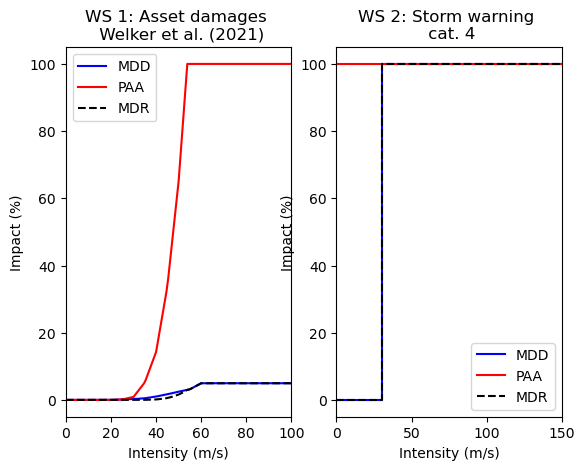

In [44]:
impf_thresh = ImpactFunc.from_step_impf([0,30.5,150],impf_id=2) # start of warning level 4 MCH
impf_thresh.intensity_unit = 'm/s'
impf_thresh.haz_type = 'WS'
impf_thresh.name = 'Storm warning \n cat. 4'
impf_set.append(impf_thresh)
impf_set.check()
impf_set.plot();

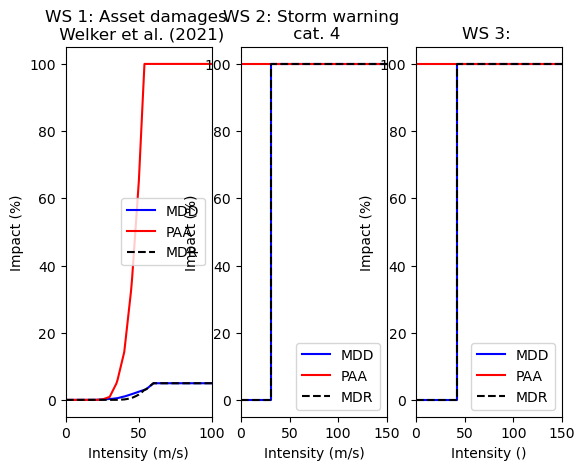

In [45]:
# not needed in the end
impf_threeblow = ImpactFunc.from_step_impf([0,42,150],impf_id=3) # tree blowdown fund
impf_threeblow.haz_type = 'WS'
impf_set.append(impf_threeblow)
impf_set.check()
impf_set.plot();


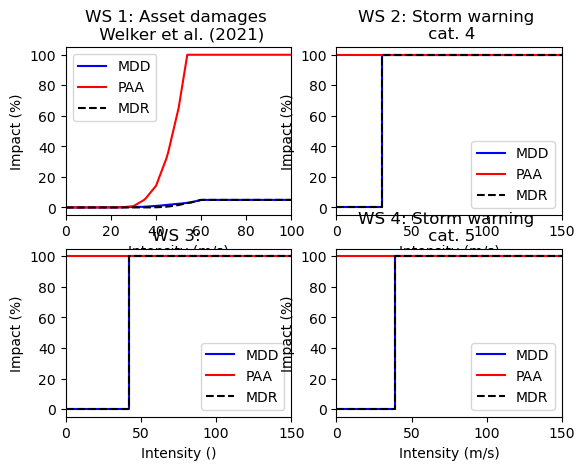

In [46]:
impf_W5 = ImpactFunc.from_step_impf([0,38.9,150],impf_id=4) # tree blowdown fund
impf_W5.intensity_unit = 'm/s'
impf_W5.haz_type = 'WS'
impf_W5.name = 'Storm warning \n cat. 5'
impf_set.append(impf_W5)
impf_set.check()
impf_set.plot();

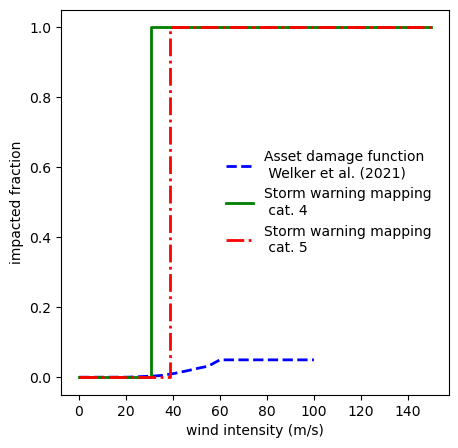

In [47]:
fig, ax = plt.subplots(1,1, figsize=(5, 5))

lp1 = ax.plot(impf_welker.intensity, impf_welker.mdd, 'b--', linewidth=2, label='Asset damage function \n Welker et al. (2021)');
ax.plot(impf_thresh.intensity, impf_thresh.mdd, 'g-', linewidth=2, label='Storm warning mapping \n cat. 4');
ax.plot(impf_W5.intensity, impf_W5.mdd, 'r-.', linewidth=2, label='Storm warning mapping \n cat. 5');
ax.set_xlabel('wind intensity (m/s)');
ax.set_ylabel('impacted fraction');
ax.legend(loc='center right', frameon=False);

#plt.savefig('./imp_funcs_all1.png', 
#                    format='png', dpi=100,
#        bbox_inches=None, pad_inches=0.1,
#        facecolor='auto', edgecolor='auto',
#        backend=None)

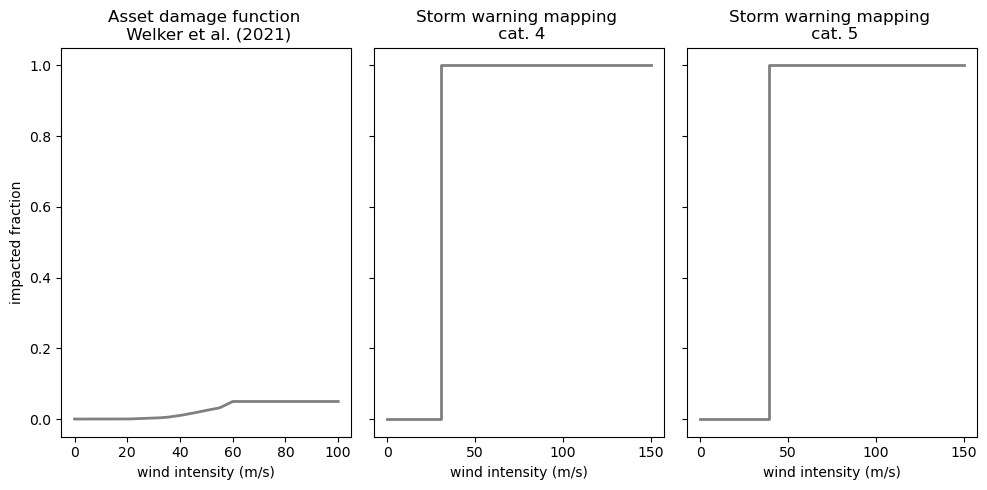

In [48]:
fig, axes = plt.subplots(1,3, figsize=(10, 5), sharey='row')

axes = axes.flatten()
lp1 = axes[0].plot(impf_welker.intensity, impf_welker.mdd, 'gray', linewidth=2)
axes[0].set_xlabel('wind intensity (m/s)')
axes[0].set_ylabel('impacted fraction')
axes[0].set_title('Asset damage function \n Welker et al. (2021)')

lp2 = axes[1].plot(impf_thresh.intensity, impf_thresh.mdd, 'gray', linewidth=2)
axes[1].set_xlabel('wind intensity (m/s)')
axes[1].set_title('Storm warning mapping \n cat. 4')

lp3 = axes[2].plot(impf_W5.intensity, impf_W5.mdd, 'gray', linewidth=2)
axes[2].set_xlabel('wind intensity (m/s)')
axes[2].set_title('Storm warning mapping \n cat. 5')

fig.tight_layout()
#plt.savefig('./imp_funcs.png', 
#                   format='png', dpi=100,
#        bbox_inches=None, pad_inches=0.1,
#        facecolor='auto', edgecolor='auto',
#        backend=None)

## Exposures

### Exposures from osm gdfs 

In [49]:
exp_health = Exposures(gdf_health)
exp_health.gdf['impf_WS'] = 2
exp_health.gdf['value'] = 1
exp_health.gdf['geometry'] = exp_health.gdf.geometry.centroid # simplify to points
exp_health.value_unit = 'units'
exp_health.set_lat_lon()
exp_health.check()

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_43839/3207582622.py:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  exp_health.gdf['geometry'] = exp_health.gdf.geometry.centroid # simplify to points


In [50]:
exp_airports = Exposures(gdf_airports)
exp_airports.gdf['impf_WS'] = 2
exp_airports.gdf['value'] = 1
exp_airports.value_unit = 'units'
exp_airports.set_lat_lon()
exp_airports.check()

In [51]:
# Making exposures with non-point geometry data:
exp_rails = Exposures(gdf_rails)
exp_rails.gdf['impf_WS'] = 2

In [52]:
gdf_forest_42 = copy.deepcopy(gdf_forest)
exp_forest_42 = Exposures(gdf_forest_42)
exp_forest_42.gdf['impf_WS'] = 3

In [53]:
gdf_forest_W4 = copy.deepcopy(gdf_forest)
exp_forest_W4 = Exposures(gdf_forest_W4)
exp_forest_W4.gdf['impf_WS'] = 2

In [54]:
gdf_forest_W5 = copy.deepcopy(gdf_forest)
exp_forest_W5 = Exposures(gdf_forest_W5)
exp_forest_W5.gdf['impf_WS'] = 4

In [55]:
# Making exposures with non-point geometry data:
exp_airport = Exposures(gdf_airports)
exp_airport.gdf['impf_WS'] = 2

In [56]:
# UNESCO heritage sites
exp_unesco = Exposures(gdf_unesco)
exp_unesco.gdf['impf_WS'] = 2
exp_unesco.gdf['value'] = 1
exp_unesco.gdf['geometry'] = exp_unesco.gdf.geometry.centroid # simplify to points
exp_unesco.value_unit = 'units'
exp_unesco.set_lat_lon()
exp_unesco.check()

/var/folders/r5/6rbkr9r16mg86237m11wqn500000gn/T/ipykernel_43839/3370603622.py:5: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  exp_unesco.gdf['geometry'] = exp_unesco.gdf.geometry.centroid # simplify to points


### Exposures from LitPop

In [57]:
# asset values (1,1)
exp_lp = LitPop().from_countries(['CHE'],reference_year=1999)
exp_lp.gdf['impf_WS'] = 1

In [58]:
# population gridded counts (0,1)
exp_pop = LitPop().from_countries(['CHE'], exponents=(0, 1), fin_mode='pop', reference_year=1999)
exp_pop.gdf['impf_WS'] = 2

### Exposure plots 

In [59]:
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from climada.util import coordinates as u_coord
import shapely
import geopandas as gpd

In [60]:
states, cntry_shape = u_coord.get_admin1_info(['CHE'])
shp_che = shapely.ops.unary_union(cntry_shape['CHE'])
gdf_che = gpd.GeoDataFrame({'geometry':[shp_che]})

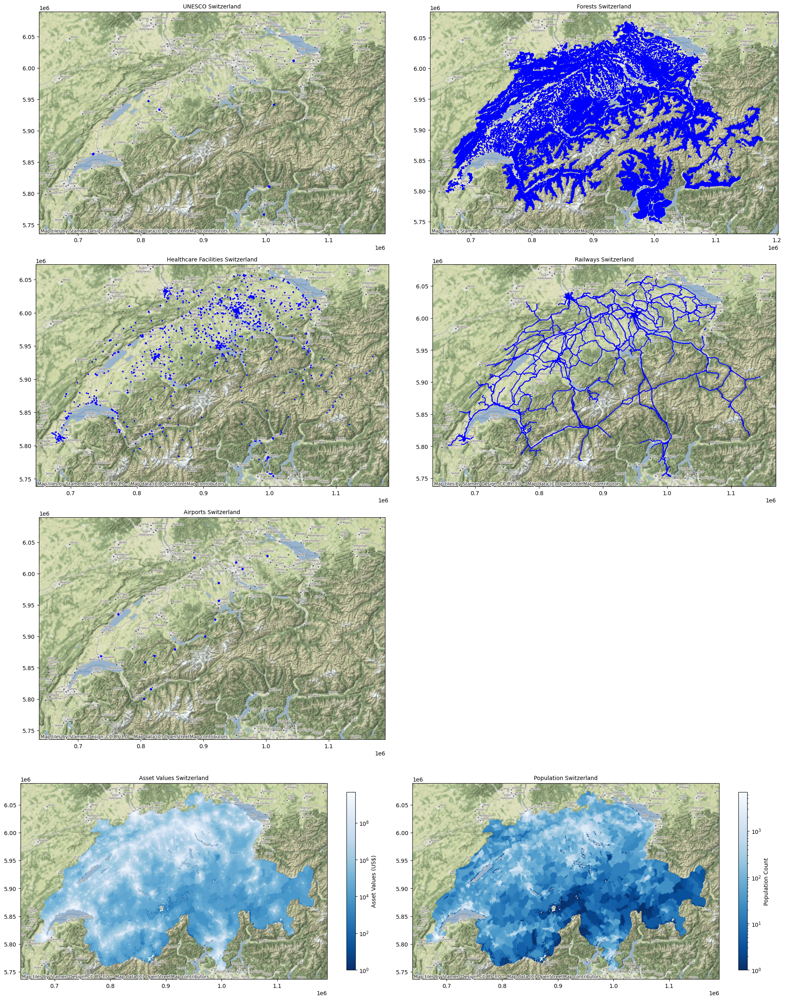

In [61]:
border = cfeature.NaturalEarthFeature('cultural', 'admin_0_countries', '50m')

fig, axes = plt.subplots(4,2, figsize=(20,25)) #subplot_kw=dict(projection=ccrs.PlateCarree())

axes = axes.flatten()

ax = gdf_unesco_plot.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[0],
    alpha=1, markersize=10, color='blue', edgecolor='blue')
gdf_che.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[0],
    alpha=0, markersize=10, color=None, edgecolor='blue')
ax.set_title('UNESCO Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = gdf_forest.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[1],
    alpha=1, color='blue', edgecolor='blue')
ax.set_title('Forests Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = gdf_health.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[2],
    alpha=1, color='blue',markersize=3, edgecolor='blue')
ax.set_title('Healthcare Facilities Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = gdf_rails.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[3],
    alpha=1, color='blue',markersize=3, edgecolor='blue')
ax.set_title('Railways Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = gdf_airports.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[4],
    alpha=1, markersize=10, color='blue', edgecolor='blue')
gdf_che.set_crs(epsg=4326).to_crs(epsg=3857).plot(ax=axes[4],
    alpha=0, markersize=10, color=None, edgecolor='blue')
ax.set_title('Airports Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = exp_lp.gdf.set_crs(epsg=4326).to_crs(epsg=3857).plot('value', ax=axes[6],
    alpha=1, cmap='Blues_r',markersize=1, legend=True,
    norm= colors.LogNorm(vmin=exp_lp.gdf.value.min()+1, vmax=exp_lp.gdf.value.max()),
    legend_kwds={'label':'Asset Values (US$)', 'shrink':0.8})
ax.set_title('Asset Values Switzerland', fontsize=10)
ctx.add_basemap(ax)

ax = exp_pop.gdf.set_crs(epsg=4326).to_crs(epsg=3857).plot('value', ax=axes[7],
    alpha=1, cmap='Blues_r',markersize=1, legend=True,
    norm= colors.LogNorm(vmin=exp_pop.gdf.value.min()+1, vmax=exp_pop.gdf.value.max()),
    legend_kwds={'label':'Population Count', 'shrink':0.8})
ax.set_title('Population Switzerland', fontsize=10)
ctx.add_basemap(ax)

fig.delaxes(axes[5])

fig.tight_layout()
# plt.savefig('./exposures.png', 
#                    format='png', dpi=150,
#        bbox_inches=None, pad_inches=0.1,
#        facecolor='auto', edgecolor='auto',
#        backend=None)
plt.show()

## Impact calculations Lothar

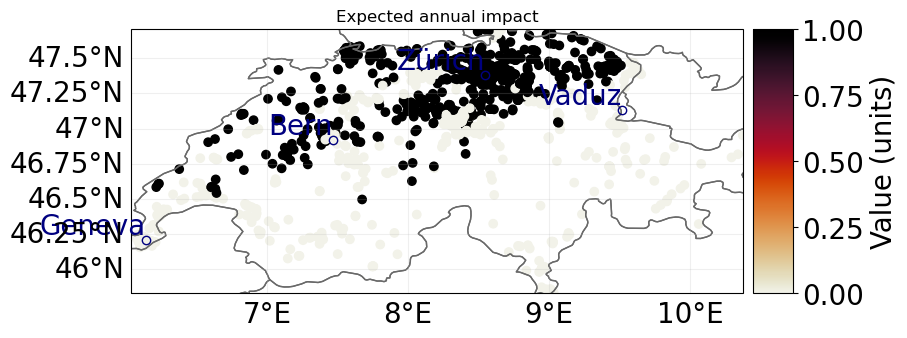

In [62]:
# Healthcare facilities
imp_health = ImpactCalc(exp_health, impf_set, ws_lothar).impact()
imp_health.plot_scatter_eai_exposure();

' \nonly for polygon-based exposure\n# all-in-one calculation for lines: \n# interpolate to 500 m resolution, assign each point a fixed value of 500 (metres),\n# and re-aggregate the sum of damages to the original exposure format\n\nimp_airport = u_lp.calc_geom_impact(\n    exp=exp_airports, impf_set=impf_set, haz=ws_lothar,\n    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,\n    agg_met=u_lp.AggMethod.SUM)\n\n# plot the impacts\nu_lp.plot_eai_exp_geom(imp_airport)\n'

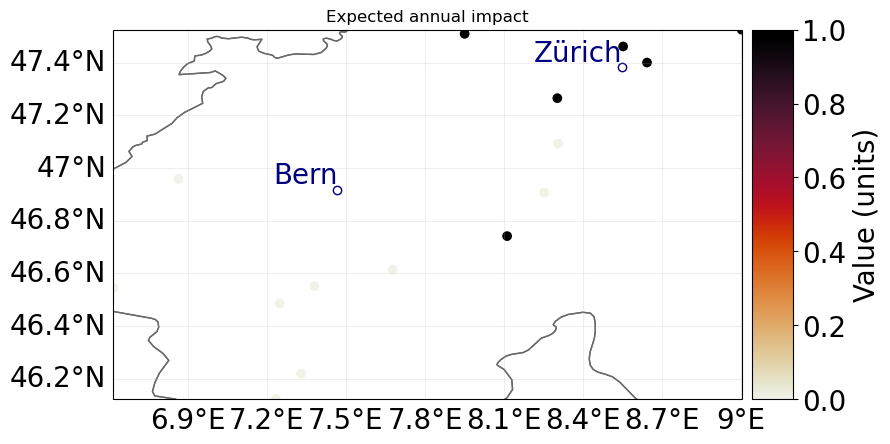

In [63]:
# Airports
imp_airport = ImpactCalc(exp_airports, impf_set, ws_lothar).impact()
imp_airport.plot_scatter_eai_exposure();

""" 
only for polygon-based exposure
# all-in-one calculation for lines: 
# interpolate to 500 m resolution, assign each point a fixed value of 500 (metres),
# and re-aggregate the sum of damages to the original exposure format

imp_airport = u_lp.calc_geom_impact(
    exp=exp_airports, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM)

# plot the impacts
u_lp.plot_eai_exp_geom(imp_airport)
"""

In [64]:
# original gdf length:
gdf_rails = gdf_rails.set_crs('EPSG:4326')
gdf_rails_proj = gdf_rails.to_crs('EPSG:2056')
gdf_rails_proj.geometry.length.sum()
# 12450052.771180911

12450052.771180911

In [65]:
# disaggregated gdf length
gdf_rails_pnt = u_lp.gdf_to_pnts(gdf_rails, res=100, to_meters=True)
#(len(gdf_rails_pnt)*100)/12450052 #v1: 1.6278646868302238 #v2: 1.1063809211399278 #v3: 1.105717143974039

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)


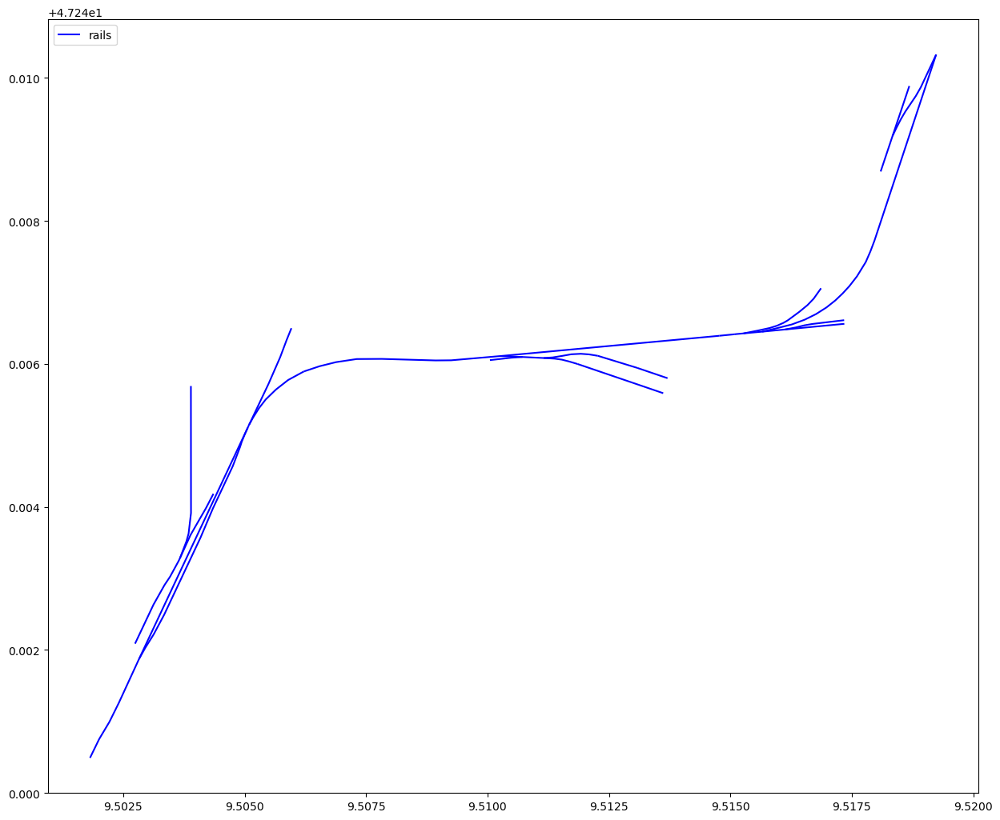

In [66]:
ax = gdf_rails.set_crs(epsg=4326).cx[ 9.4:9.7, 47.235:47.25].plot(figsize=(15, 15), alpha=1, markersize=20, color='blue', 
                    edgecolor='blue', label='rails')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
plt.show()

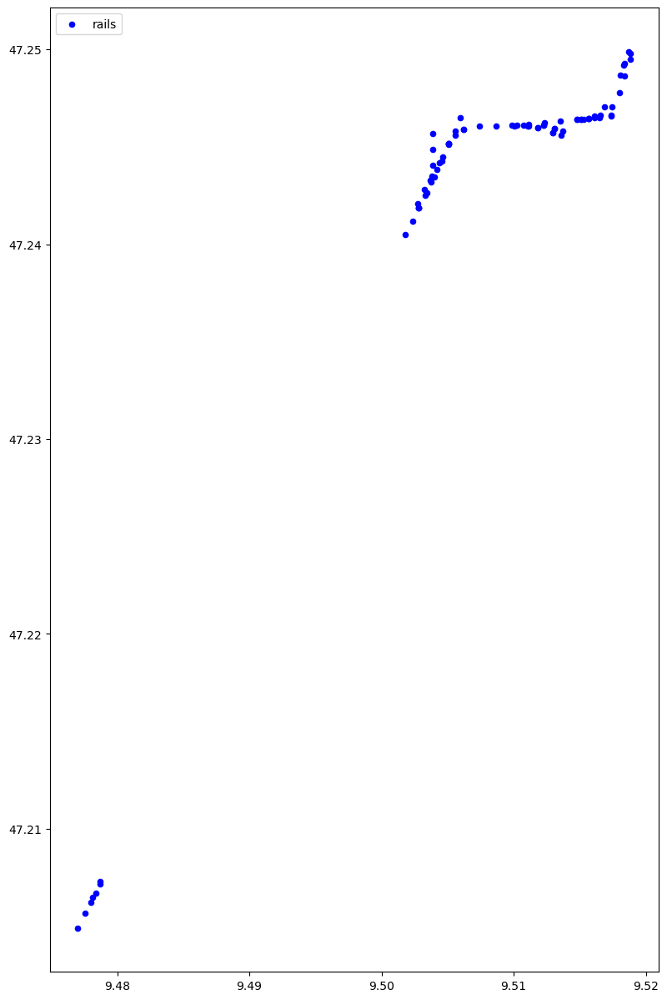

In [67]:
ax = gdf_rails_pnt.set_crs(epsg=4326).cx[ 9.4:9.7, 47.2:47.25].plot(figsize=(15, 15), alpha=1, markersize=20, color='blue', 
                    edgecolor='blue', label='rails')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
plt.show()

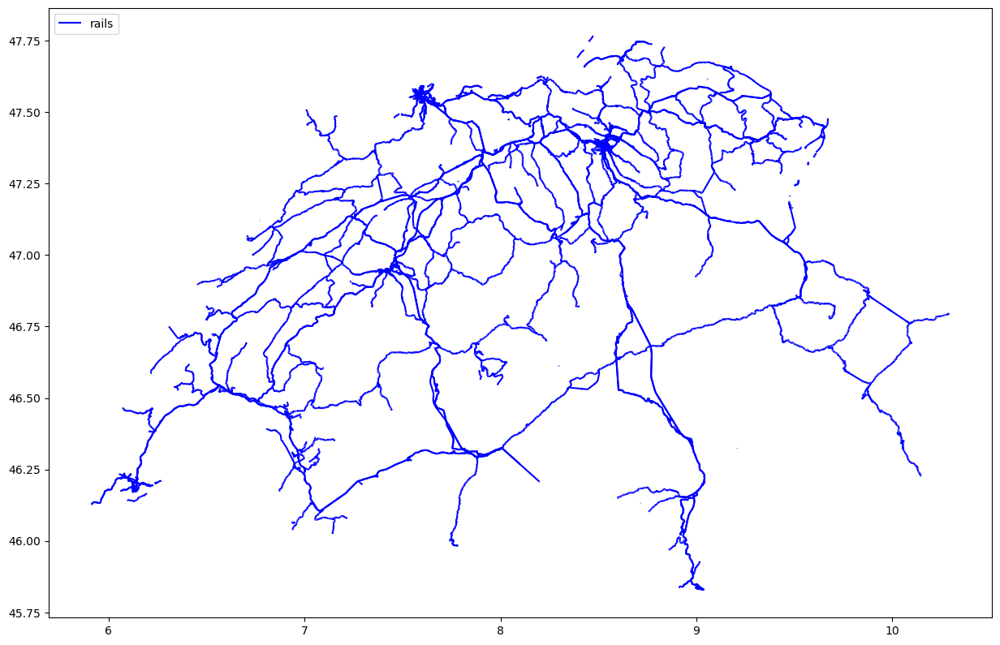

In [68]:
ax = gdf_rails.set_crs(epsg=4326).plot(figsize=(15, 15), alpha=1, markersize=20, color='blue', 
                    edgecolor='blue', label='rails')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
plt.show()

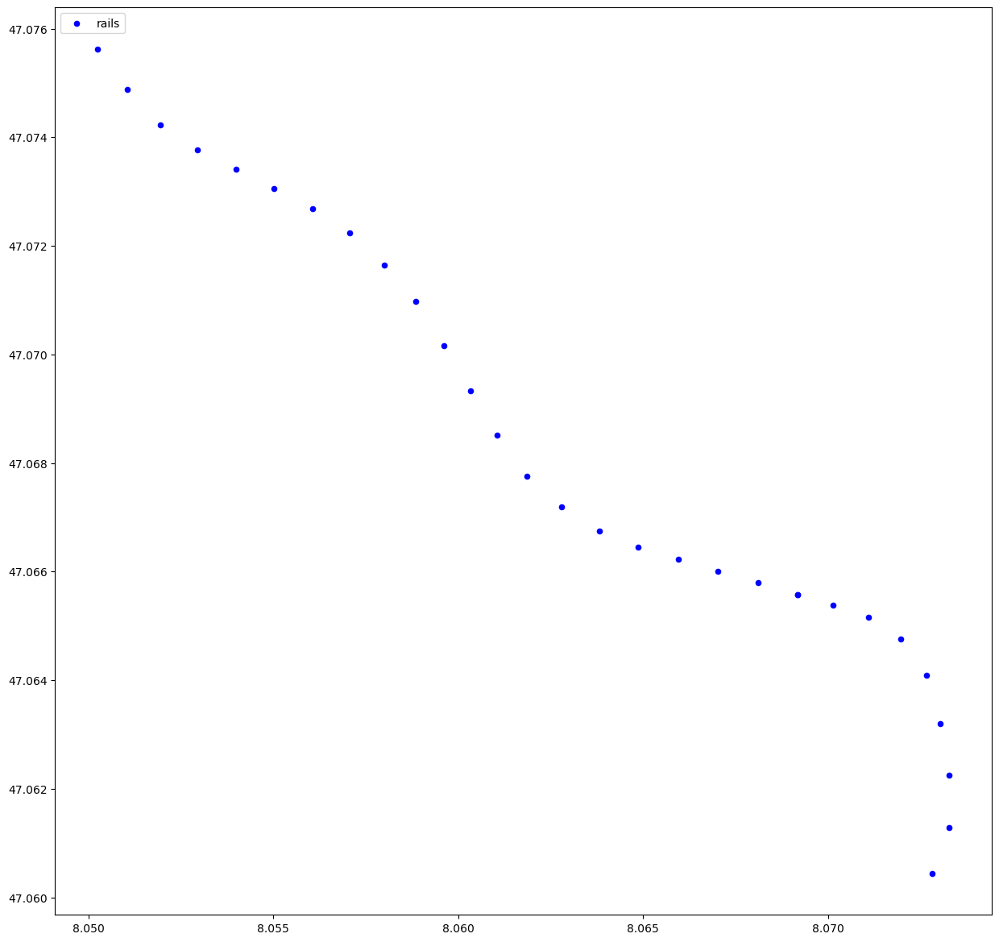

In [69]:
ax = gdf_rails_pnt.set_crs(epsg=4326).cx[ 8.05:8.09, 47.06:47.1].plot(figsize=(15, 15), alpha=1, markersize=20, color='blue', 
                    edgecolor='blue', label='rails')
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, loc='upper left')
plt.show()

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)


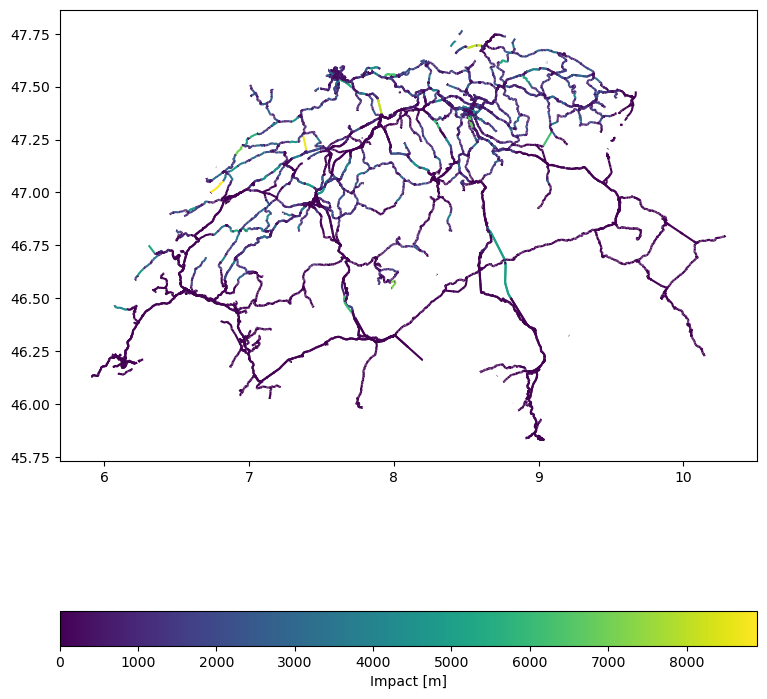

In [70]:
# railways

# all-in-one calculation for lines: 
# interpolate to 100 m resolution, assign each point a fixed value of 100 (metres),
# and re-aggregate the sum of damages to the original exposure format
imp_rails = u_lp.calc_geom_impact(
    exp=exp_rails, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100,
    agg_met=u_lp.AggMethod.SUM
)
imp_rails.unit = 'm'

# plot the impacts
u_lp.plot_eai_exp_geom(imp_rails);

In [71]:
impf_set.get_func()

{'WS': {1: <climada.entity.impact_funcs.storm_europe.ImpfStormEurope at 0x183bde490>,
  2: <climada.entity.impact_funcs.base.ImpactFunc at 0x183b53fa0>,
  3: <climada.entity.impact_funcs.base.ImpactFunc at 0x183b61b20>,
  4: <climada.entity.impact_funcs.base.ImpactFunc at 0x183a3a0d0>}}

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:387: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  iter(obj)  # Can iterate over it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:388: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  len(obj)  # Has a length associated with it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_arra

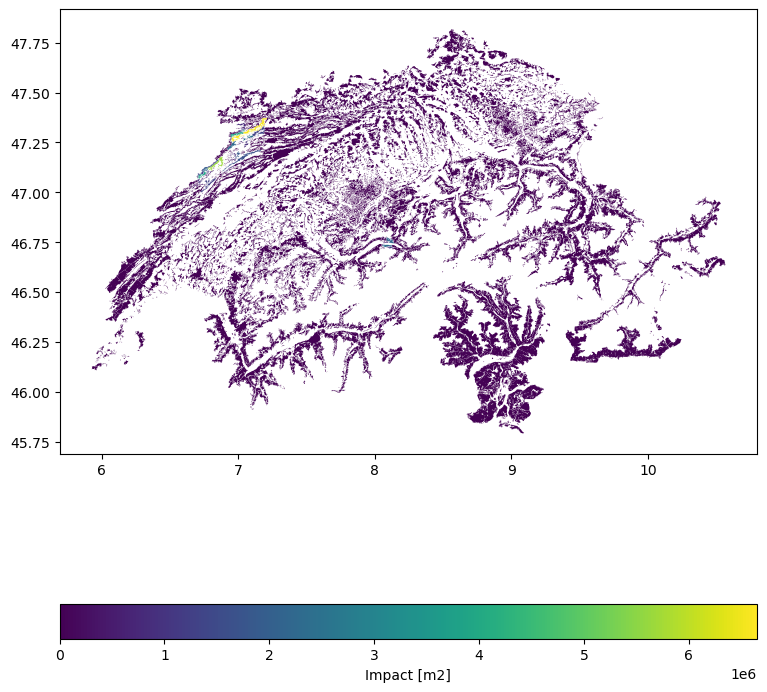

In [72]:
# Forest, with imp func 3 (>42)

imp_forest_42 = u_lp.calc_geom_impact(
    exp=exp_forest_42, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_42.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_42);

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:387: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  iter(obj)  # Can iterate over it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:388: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  len(obj)  # Has a length associated with it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_arra

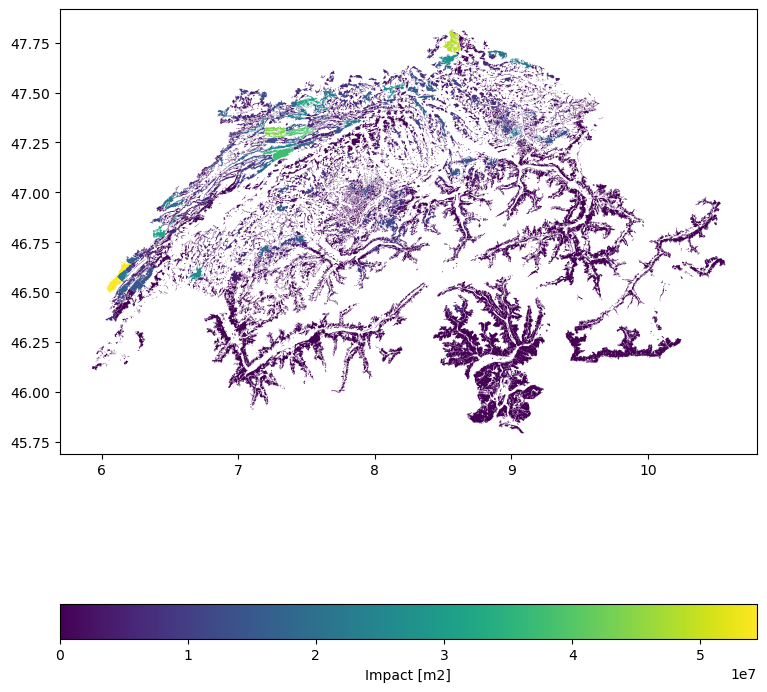

In [73]:
# Forest, with imp func 2 (>30.5)

imp_forest_W4 = u_lp.calc_geom_impact(
    exp=exp_forest_W4, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_W4.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_W4);

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:387: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  iter(obj)  # Can iterate over it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:388: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  len(obj)  # Has a length associated with it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_arra

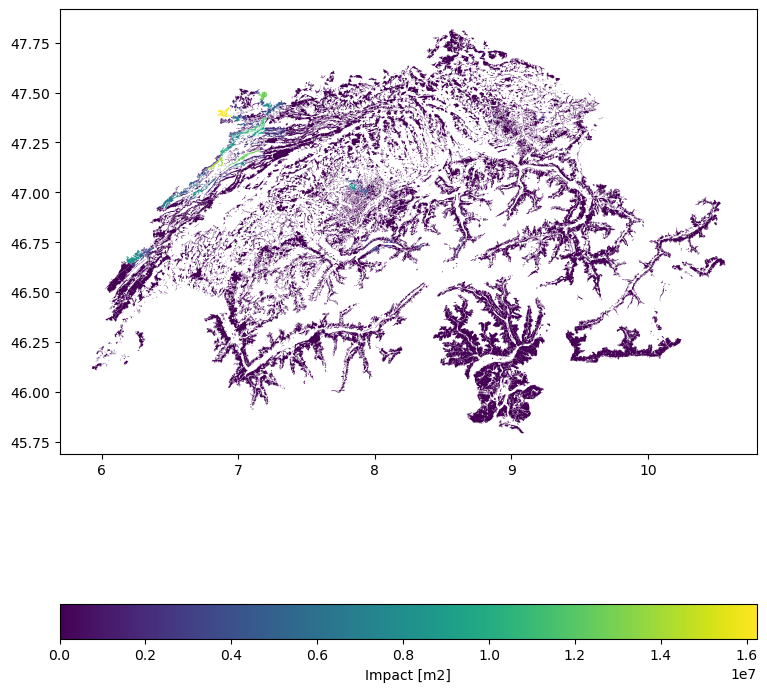

In [74]:
# Forest, with imp func 4 (>W5)

imp_forest_W5 = u_lp.calc_geom_impact(
    exp=exp_forest_W5, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_W5.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_W5);

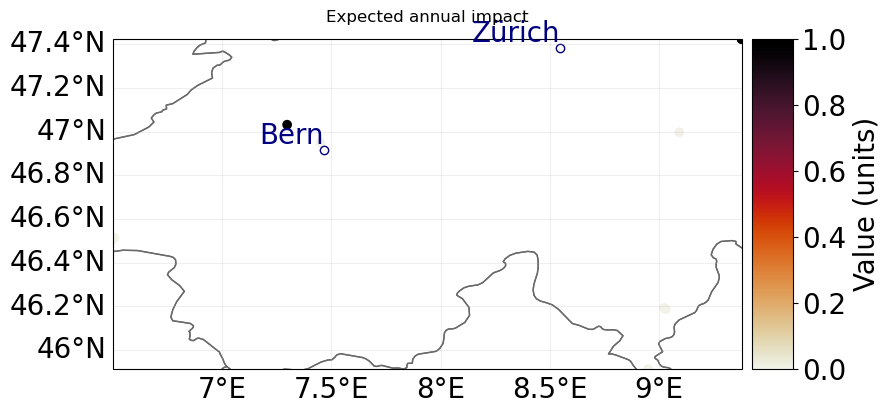

In [75]:
# Unesco heritage sites
imp_unesco = ImpactCalc(exp_unesco, impf_set, ws_lothar).impact()
imp_unesco.plot_scatter_eai_exposure();

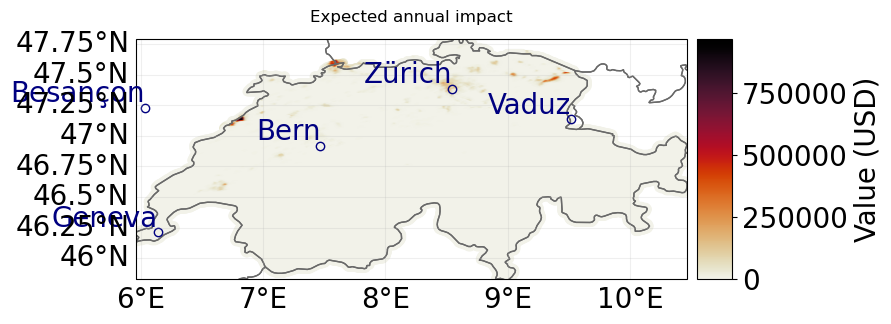

In [76]:
imp_lp = ImpactCalc(exp_lp, impf_set, ws_lothar).impact()
imp_lp.plot_scatter_eai_exposure();

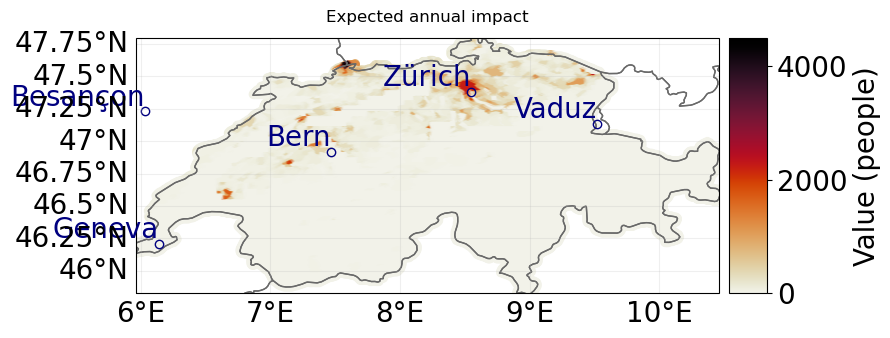

In [77]:
imp_pop = ImpactCalc(exp_pop, impf_set, ws_lothar).impact()
imp_pop.plot_scatter_eai_exposure();

In [78]:
imp_health_nz = imp_health.select(coord_exp = imp_health.coord_exp[np.bool8(imp_health.eai_exp)])
imp_airport_nz = imp_airport.select(coord_exp = imp_airport.coord_exp[np.bool8(imp_airport.eai_exp)])
imp_unesco_nz = imp_unesco.select(coord_exp = imp_unesco.coord_exp[np.bool8(imp_unesco.eai_exp)])
imp_pop_nz = imp_pop.select(coord_exp = imp_pop.coord_exp[imp_pop.eai_exp>500])
imp_lp_nz = imp_lp.select(coord_exp = imp_lp.coord_exp[imp_lp.eai_exp>5000])

In [79]:
imp_forest_nz_geom = imp_forest_W5.geom_exp[imp_forest_W5.eai_exp > 0]
imp_rails_nz_geom = imp_rails.geom_exp[imp_rails.eai_exp > 0]

In [80]:
geometry = gpd.points_from_xy(imp_health_nz.coord_exp.T[1], imp_health_nz.coord_exp.T[0], crs=4326)
gdf = gpd.GeoDataFrame({'value' : np.repeat('Healthcare facility', len(geometry))}, geometry=geometry)
geometry = gpd.points_from_xy(imp_airport_nz.coord_exp.T[1], imp_airport_nz.coord_exp.T[0], crs=4326)
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Airport', len(geometry))}, geometry=geometry)])
geometry = gpd.points_from_xy(imp_unesco_nz.coord_exp.T[1], imp_unesco_nz.coord_exp.T[0], crs=4326)
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('UNESCO site', len(geometry))}, geometry=geometry)])
geometry = imp_forest_nz_geom.values
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Forest', len(geometry))}, geometry=geometry)])
geometry = imp_rails_nz_geom.values
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Railways', len(geometry))}, geometry=geometry)])
geometry = gpd.points_from_xy(imp_lp_nz.coord_exp.T[1], imp_lp_nz.coord_exp.T[0], crs=4326)
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Assets', len(geometry))}, geometry=geometry)])
geometry = gpd.points_from_xy(imp_pop_nz.coord_exp.T[1], imp_pop_nz.coord_exp.T[0], crs=4326)
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('People', len(geometry))}, geometry=geometry)])

In [81]:
geometry = gpd.points_from_xy(imp_health_nz.coord_exp.T[1], imp_health_nz.coord_exp.T[0], crs=4326)
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Healthcare facility', len(geometry))}, geometry=geometry)])
geometry = imp_forest_nz_geom.values
gdf = pd.concat([gdf, gpd.GeoDataFrame({'value' : np.repeat('Forest', len(geometry))}, geometry=geometry)])

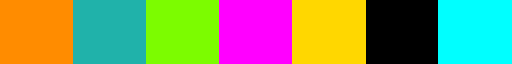

In [82]:
import matplotlib as mpl
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
cmap = ListedColormap(["darkorange", "lightseagreen", "lawngreen", "magenta", "gold", "black", "cyan"])
cmap

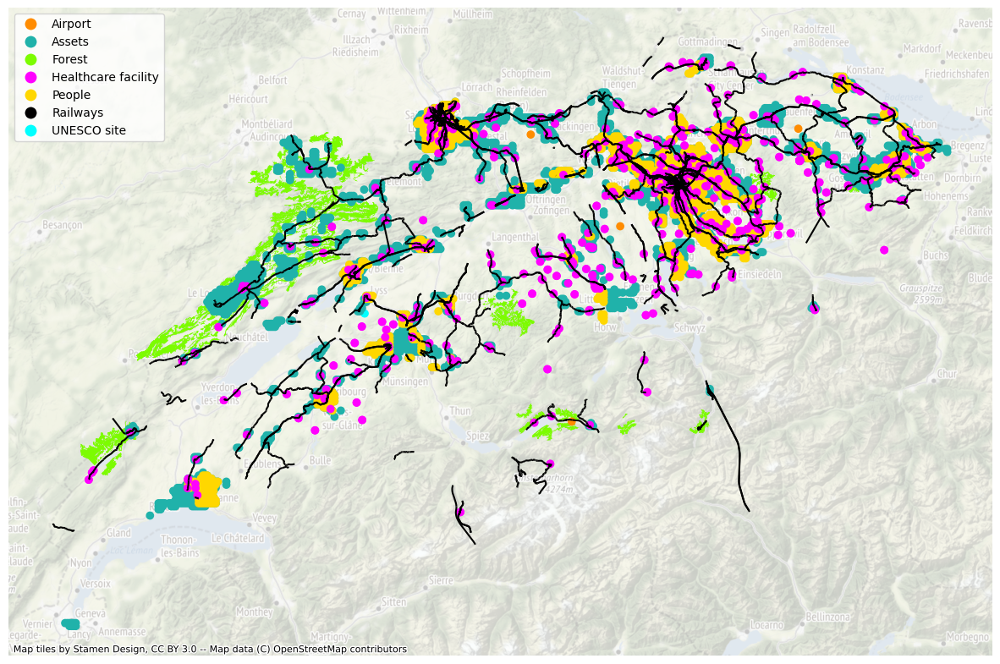

In [83]:
ax = gdf.to_crs(epsg=3857).plot('value', categorical=True, legend=True, figsize=(15, 15), cmap = cmap, )
#handles, labels = ax.get_legend_handles_labels()
#ax.legend(handles=handles, loc='upper left')
#ax.set_title('Impacted elements', fontsize=25)
ctx.add_basemap(ax, alpha=0.3)
plt.axis('off')
plt.show()

### Summary table Lothar

In [149]:
summary_table_lothar = pd.DataFrame()
summary_table_lothar['exposure'] = ['Asset Values', 'Population', 'Healthcare Facilities', 'Airports','UNESCO world heritage sites',
                             'Railways', 'Forest Area (>W5)']
summary_table_lothar['impact'] = [imp.aai_agg for imp in [imp_lp, imp_pop, imp_health, imp_airport, imp_unesco,
                                                         imp_rails, imp_forest_W5]]
summary_table_lothar['metric'] = ['USD', 'people', 'units', 'units','units', 'm', 'm2']

In [150]:
summary_table_lothar

,exposure,impact,metric
0,Asset Values,1.794103e+08,USD
1,Population,4.175326e+06,people
2,Healthcare Facilities,6.490000e+02,units
3,Airports,6.000000e+00,units
4,UNESCO world heritage sites,3.000000e+00,units
5,Railways,1.022020e+07,m
6,Forest Area (>W5),4.646000e+08,m2


In [86]:
len(gdf_health)

1155

In [87]:
imp_airport.aai_agg/len(gdf_airports)

0.4

In [88]:
imp_rails.aai_agg/(len(gdf_rails_pnt)*100)

0.5042778901662801

In [89]:
imp_rails.aai_agg/(len(gdf_rails_pnt)*100)

0.5042778901662801

In [90]:
imp_rails.aai_agg

10220200.0

In [91]:
imp_unesco.aai_agg/len(gdf_unesco)

0.2727272727272727

In [92]:
imp_forest_W5.aai_agg/12555980000

0.037002288949170035

In [93]:
len(gdf_unesco)

11

In [94]:
imp_health.aai_agg/len(gdf_health)

0.5619047619047619

In [95]:
imp_pop.aai_agg/exp_pop.gdf.value.sum()

0.57596355218776

In [96]:
imp_lp.aai_agg/exp_lp.gdf.value.sum()*100

0.010479050501956763

### Verification Data Lothar

In [97]:
# building damage estimated: 600 million
imp_lp.aai_agg / 6e8

0.2990172301127822

In [98]:
# reported forest damage: 46000 ha (ca. 4.3% of total forest area)
# Damage value: 750 million 
area_forest_imp = 46000*10000
# total estimated forest area CH
area_forest_tot = area_forest_imp/0.043
# value per m2 of forest
val_per_m2_forest = 750*1e6/area_forest_imp

print('Areas OSM vs. Areas estimated CH', 12555980000/10000000000 )

print('Forest with 42m/s thresh: ', imp_forest_42.aai_agg/460000000)
print('Forest with > W4 thresh: ',imp_forest_W4.aai_agg/460000000)
print('Forest with > W5 thresh: ',imp_forest_W5.aai_agg/460000000)

Areas OSM vs. Areas estimated CH 1.255598
Forest with 42m/s thresh:  0.17547826086956522
Forest with > W4 thresh:  10.709108695652175
Forest with > W5 thresh:  1.01


In [99]:
"""
Durch umstürzende Bäume und Fahrleitungsrisse wurden zahlreiche Eisenbahnverbindungen in der 
gesamten Deutschschweiz unterbrochen. 
Die SBB hielten den Betrieb jedoch entsprechend den Umständen auf den nicht betroffenen Linien aufrecht. 
"""

'\nDurch umstürzende Bäume und Fahrleitungsrisse wurden zahlreiche Eisenbahnverbindungen in der \ngesamten Deutschschweiz unterbrochen. \nDie SBB hielten den Betrieb jedoch entsprechend den Umständen auf den nicht betroffenen Linien aufrecht. \n'

## Risk calculations Winterstorms probabilistic

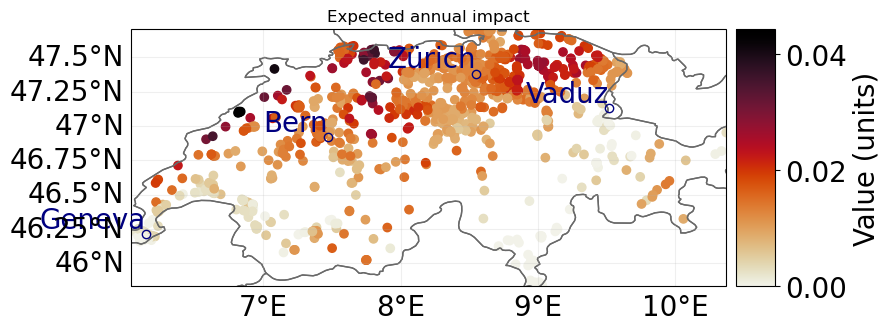

In [100]:
# Healthcare facilities
imp_health_ws = ImpactCalc(exp_health, impf_set, ws_che).impact()
imp_health_ws.plot_scatter_eai_exposure();

' \nonly for polygon-based exposure\n# all-in-one calculation for lines: \n# interpolate to 500 m resolution, assign each point a fixed value of 500 (metres),\n# and re-aggregate the sum of damages to the original exposure format\n\nimp_airport = u_lp.calc_geom_impact(\n    exp=exp_airports, impf_set=impf_set, haz=ws_lothar,\n    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,\n    agg_met=u_lp.AggMethod.SUM)\n\n# plot the impacts\nu_lp.plot_eai_exp_geom(imp_airport)\n'

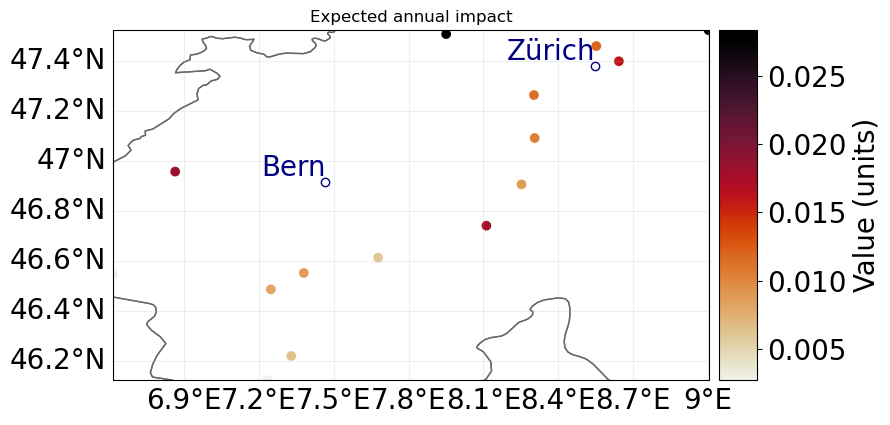

In [101]:
# Airports
imp_airport_ws = ImpactCalc(exp_airports, impf_set, ws_che).impact()
imp_airport_ws.plot_scatter_eai_exposure();

""" 
only for polygon-based exposure
# all-in-one calculation for lines: 
# interpolate to 500 m resolution, assign each point a fixed value of 500 (metres),
# and re-aggregate the sum of damages to the original exposure format

imp_airport = u_lp.calc_geom_impact(
    exp=exp_airports, impf_set=impf_set, haz=ws_lothar,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM)

# plot the impacts
u_lp.plot_eai_exp_geom(imp_airport)
"""

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)


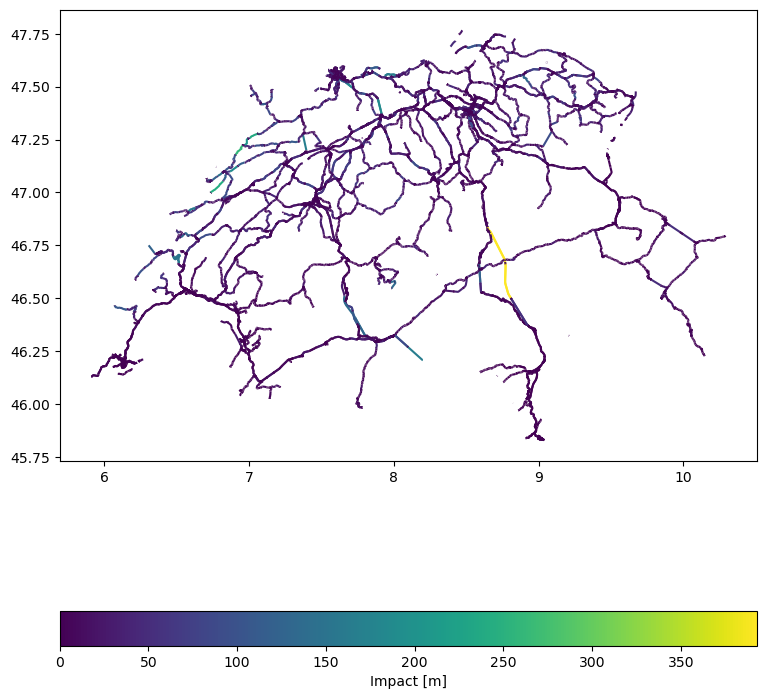

In [102]:
# railways

# all-in-one calculation for lines: 
# interpolate to 100 m resolution, assign each point a fixed value of 100 (metres),
# and re-aggregate the sum of damages to the original exposure format
imp_rails_ws = u_lp.calc_geom_impact(
    exp=exp_rails, impf_set=impf_set, haz=ws_che,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100,
    agg_met=u_lp.AggMethod.SUM
)
imp_rails_ws.unit = 'm'

# plot the impacts
u_lp.plot_eai_exp_geom(imp_rails_ws);

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:387: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  iter(obj)  # Can iterate over it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:388: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  len(obj)  # Has a length associated with it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_arra

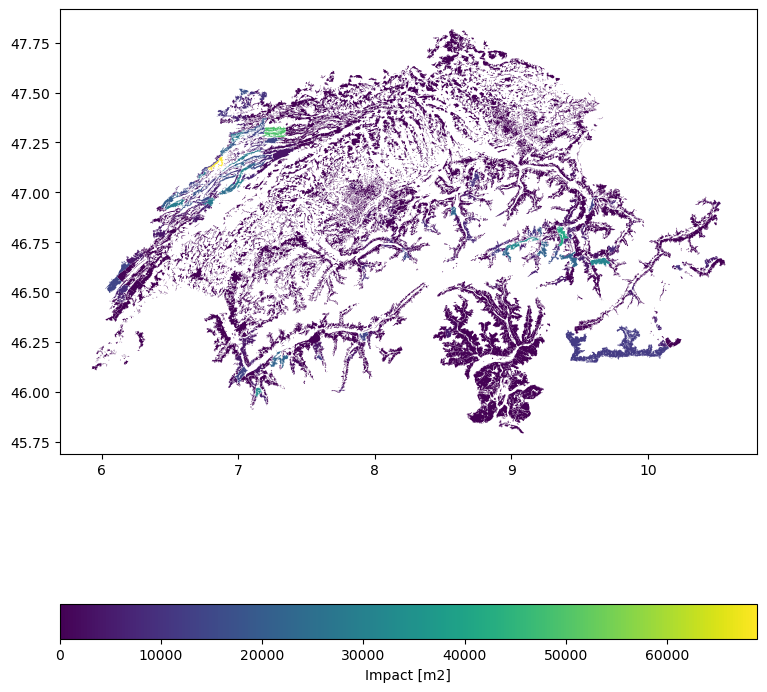

In [103]:
# Forest, with imp func 3 (>42)

imp_forest_42_ws = u_lp.calc_geom_impact(
    exp=exp_forest_42, impf_set=impf_set, haz=ws_che,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_42_ws.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_42_ws);

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:387: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  iter(obj)  # Can iterate over it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:388: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  len(obj)  # Has a length associated with it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_arra

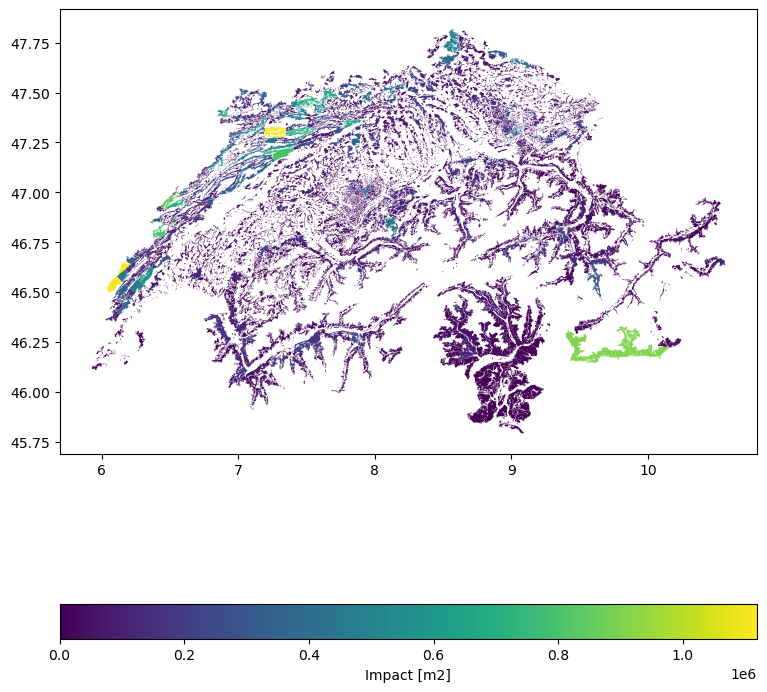

In [104]:
# Forest, with imp func 2 (>30.5)

imp_forest_W4_ws = u_lp.calc_geom_impact(
    exp=exp_forest_W4, impf_set=impf_set, haz=ws_che,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_W4_ws.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_W4_ws);

/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:387: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  iter(obj)  # Can iterate over it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/inference.py:388: ShapelyDeprecationWarning: __len__ for multi-part geometries is deprecated and will be removed in Shapely 2.0. Check the length of the `geoms` property instead to get the  number of parts of a multi-part geometry.
  len(obj)  # Has a length associated with it.
/Users/ckropf/opt/anaconda3/envs/climada_333/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:127: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_arra

<AxesSubplot:>

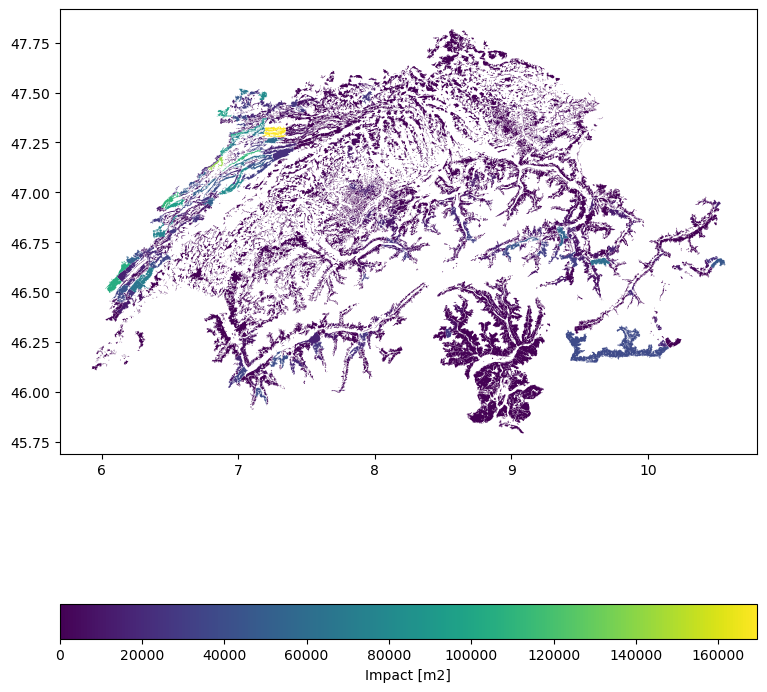

In [105]:
# Forest, withLitPopp func 4 (>W5)

imp_forest_W5_ws = u_lp.calc_geom_impact(
    exp=exp_forest_W5, impf_set=impf_set, haz=ws_che,
    res=100, to_meters=True, disagg_met=u_lp.DisaggMethod.FIX, disagg_val=100*100,
    agg_met=u_lp.AggMethod.SUM
)
imp_forest_W5_ws.unit = 'm2'

# plot results.
u_lp.plot_eai_exp_geom(imp_forest_W5_ws)

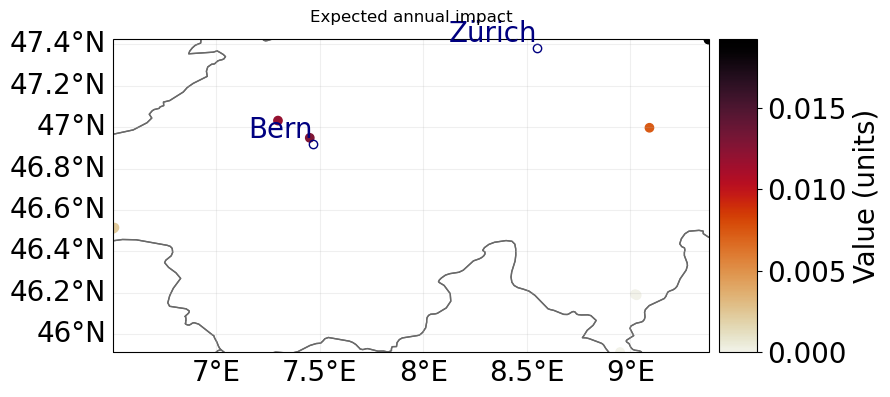

In [106]:
# Unesco heritage sites
imp_unesco_ws = ImpactCalc(exp_unesco, impf_set, ws_che).impact()
imp_unesco_ws.plot_scatter_eai_exposure();

In [199]:
exp_lp_2020 = LitPop().from_countries('CHE', reference_year=2020)

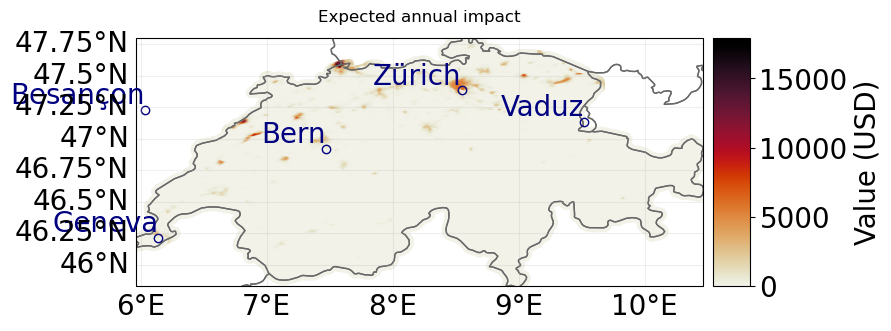

In [200]:
imp_lp_ws = ImpactCalc(exp_lp_2020, impf_set, ws_che).impact()
imp_lp_ws.plot_scatter_eai_exposure();

In [108]:
exp_pop_2020 = LitPop().from_countries('CHE', reference_year=2020, fin_mode='pop', exponents=(0, 1))

<GeoAxesSubplot:title={'center':'Expected annual impact'}>

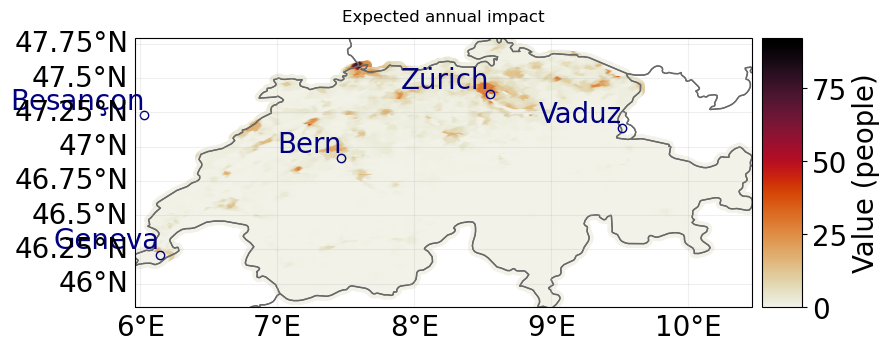

In [109]:
imp_pop_ws = ImpactCalc(exp_pop, impf_set, ws_che).impact()
imp_pop_ws.plot_scatter_eai_exposure()

### Summary table Risk WS

In [201]:
summary_table_ws = pd.DataFrame()
summary_table_ws['exposure'] = ['Asset Values', 'Population', 'Healthcare Facilities', 'Airports','UNESCO world heritage sites',
                             'Railways', 'Forest Area (>W5)']
summary_table_ws['average annual impact'] = [imp.aai_agg for imp in [imp_lp_ws, imp_pop_ws, imp_health_ws, imp_airport_ws, imp_unesco_ws,
                                                         imp_rails_ws, imp_forest_W5_ws]]
summary_table_ws['metric'] = ['USD', 'people', 'units', 'units','units', 'm', 'm2']

In [202]:
summary_table_ws

,exposure,average annual impact,metric
0,Asset Values,6.406225e+06,USD
1,Population,9.128907e+04,people
2,Healthcare Facilities,1.461416e+01,units
3,Airports,1.849315e-01,units
4,UNESCO world heritage sites,7.488584e-02,units
5,Railways,2.527149e+05,m
6,Forest Area (>W5),9.834516e+06,m2


In [203]:
9.837187e+06 / 10000

983.7187

In [204]:
len(gdf_health)

1155

In [205]:
imp_airport_ws.aai_agg/len(gdf_airports)

0.012328767123287664

In [206]:
imp_rails_ws.aai_agg/(len(gdf_rails_pnt)*100)

0.012469281665113208

In [207]:
imp_unesco_ws.aai_agg/len(gdf_unesco)

0.006807804068078038

In [208]:
imp_forest_W5_ws.aai_agg/12555980000

0.0007832535558144537

In [209]:
len(gdf_unesco)

11

In [210]:
imp_health_ws.aai_agg/len(gdf_health)

0.012652948269386618

In [211]:
imp_pop_ws.aai_agg/exp_pop.gdf.value.sum()

0.012592830594488246

In [212]:
imp_lp_ws.aai_agg/exp_lp.gdf.value.sum() * 100

0.0003741766400302681

### Return period curves WS 

In [213]:
return_per=np.arange(1,250)

In [214]:
values = summary_table_lothar['impact']
exp_type_list = summary_table_lothar['exposure']
lothar_impacts = {t : val for t, val in zip(exp_type_list, values)}
lothar_impacts

{'Asset Values': 179410338.06766933,
 'Population': 4175326.243275654,
 'Healthcare Facilities': 649.0,
 'Airports': 6.0,
 'UNESCO world heritage sites': 3.0,
 'Railways': 10220200.0,
 'Forest Area (>W5)': 464600000.0}

In [215]:
imp_lp_list = [imp_lp_ws, imp_pop_ws, imp_health_ws, imp_airport_ws, imp_unesco_ws, imp_rails_ws, imp_forest_W5_ws]
imp_lp_dict = {t: val for t, val in zip(exp_type_list, imp_lp_list)}

In [216]:
import numpy as np
def find_rp(rp_curve, impact):
    rp_impacts = rp_curve.impact
    idx = (np.abs(rp_impacts - impact)).argmin()
    return rp_curve.return_per[idx]

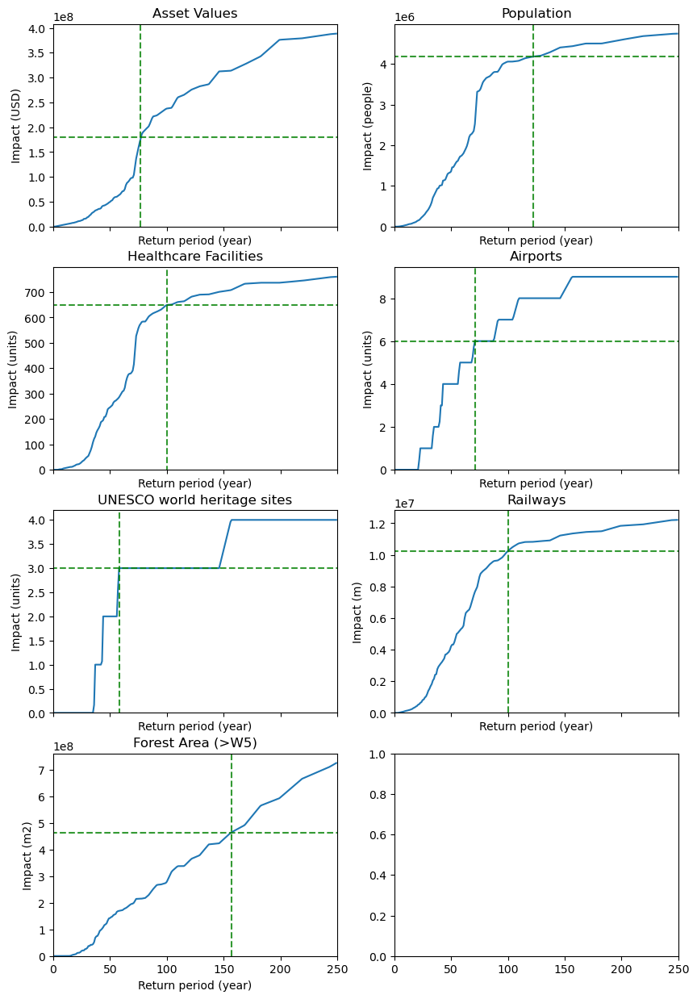

In [220]:
fig, axes = plt.subplots(figsize=(10, 15), ncols=2, nrows=4, sharex=True)
for ax, exp_type in zip(axes.flatten(), exp_type_list):
    rp_curve = imp_lp_dict[exp_type].calc_freq_curve(return_per=return_per)
    rp_curve.plot(axis=ax)
    rp_lothar = find_rp(rp_curve, lothar_impacts[exp_type])
    ax.set_title(exp_type);
    ax.hlines(lothar_impacts[exp_type], -10, 300, color='g', linestyle='--', alpha=0.8)
    ax.vlines(rp_lothar, -10, 2*max(rp_curve.impact), color='g', linestyle='--', alpha=0.8)
    ax.set_xlim([0, 250])
    ax.set_ylim(0, max(rp_curve.impact)*1.05)

In [221]:
rp_list = []
for exp_type in exp_type_list:
    rp_curve = imp_lp_dict[exp_type].calc_freq_curve(return_per=return_per)
    rp_lothar = find_rp(rp_curve, lothar_impacts[exp_type])
    rp_list.append(rp_lothar)

summary_table_rp_ws = pd.DataFrame()
summary_table_rp_ws['exposure'] = ['Asset Values', 'Population', 'Healthcare Facilities', 'Airports','UNESCO world heritage sites',
                             'Railways', 'Forest Area (>W5)']
summary_table_rp_ws['Return period'] = rp_list
summary_table_rp_ws['metric'] = ['Years', 'Years', 'Years', 'Years','Years', 'Years', 'Years']

In [222]:
summary_table_rp_ws

,exposure,Return period,metric
0,Asset Values,77,Years
1,Population,122,Years
2,Healthcare Facilities,100,Years
3,Airports,71,Years
4,UNESCO world heritage sites,58,Years
5,Railways,100,Years
6,Forest Area (>W5),157,Years
